In [1]:
import scanpy as sc
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np
from functions import * # my custom functions 
import scib
import pickle

from sklearn.model_selection import train_test_split, StratifiedKFold
from scHPL import train, predict, update, learn, utils, evaluate
from contextlib import redirect_stdout

# rpy2 for running R code|
import rpy2.rinterface_lib.callbacks
import logging
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR) # Ignore R warning messages
import rpy2.robjects as ro
import anndata2ri

# scanpy config
sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(frameon=False, dpi_save=1000)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/importlib/_bootstrap.py:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject
  return f(*args, **kwds)


scanpy==1.8.2 anndata==0.8.0 umap==0.5.1 numpy==1.19.5 scipy==1.5.4 pandas==1.1.5 scikit-learn==0.23.2 statsmodels==0.13.0 python-igraph==0.9.6 louvain==0.7.0 pynndescent==0.5.5


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/umap/__init__.py:11: ImportWarning: Tensorflow not installed; ParametricUMAP will be unavailable
  category=ImportWarning


In [2]:
import platform,socket,re,uuid,json,psutil,logging

def getSystemInfo():
    try:
        info={}
        info['platform']=platform.system()
        info['platform-release']=platform.release()
        info['platform-version']=platform.version()
        info['architecture']=platform.machine()
        info['processor']=platform.processor()
        info['ram']=str(round(psutil.virtual_memory().total / (1024.0 **3)))+" GB"
        return json.dumps(info)
    except Exception as e:
        logging.exception(e)

json.loads(getSystemInfo())

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


{'platform': 'Linux',
 'platform-release': '4.18.0-373.el8.x86_64',
 'platform-version': '#1 SMP Tue Mar 22 15:11:47 UTC 2022',
 'architecture': 'x86_64',
 'processor': 'x86_64',
 'ram': '378 GB'}

In [3]:
MY_PALETTES = dict(
    deep=["#4C72B0", "#DD8452", "#55A868", "#C44E52", "#8172B3",
          "#937860", "#DA8BC3", "#b5bd61", "#CCB974", "#64B5CD"],
    deep6=["#4C72B0", "#55A868", "#C44E52",
           "#8172B3", "#CCB974", "#64B5CD"],
    muted=["#4878D0", "#EE854A", "#6ACC64", "#D65F5F", "#956CB4",
           "#8C613C", "#DC7EC0", "#797979", "#D5BB67", "#82C6E2"],
    muted6=["#4878D0", "#6ACC64", "#D65F5F",
            "#956CB4", "#D5BB67", "#82C6E2"],
    pastel=["#A1C9F4", "#FFB482", "#8DE5A1", "#FF9F9B", "#D0BBFF",
            "#DEBB9B", "#FAB0E4", "#CFCFCF", "#FFFEA3", "#B9F2F0"],
    pastel6=["#A1C9F4", "#8DE5A1", "#FF9F9B",
             "#D0BBFF", "#FFFEA3", "#B9F2F0"],
    bright=["#023EFF", "#FF7C00", "#1AC938", "#E8000B", "#8B2BE2",
            "#9F4800", "#F14CC1", "#A3A3A3", "#FFC400", "#00D7FF"],
    bright6=["#023EFF", "#1AC938", "#E8000B",
             "#8B2BE2", "#FFC400", "#00D7FF"],
    dark=["#001C7F", "#B1400D", "#12711C", "#8C0800", "#591E71",
          "#592F0D", "#A23582", "#3C3C3C", "#B8850A", "#006374"],
    dark6=["#001C7F", "#12711C", "#8C0800",
           "#591E71", "#B8850A", "#006374"],
    colorblind=["#0173B2", "#DE8F05", "#029E73", "#D55E00", "#CC78BC",
                "#CA9161", "#FBAFE4", "#949494", "#ECE133", "#56B4E9"],
    colorblind6=["#0173B2", "#029E73", "#D55E00",
                 "#CC78BC", "#ECE133", "#56B4E9"]
)

# Hierarchichal classifier

We train the classifier using the reference atlas. That is, the part of the atlas that was annotated (Park18, Janosevic21, Kirita20, Miao21, Wu19, Dumas20)

## scHPL: Celltype learning and prediction

In [4]:
atlas = sc.read_h5ad("/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_raw.h5ad")
integrated_atlas = sc.read_h5ad("/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_full_SCVI_SCANVI.h5ad")

In [5]:
integrated_atlas, atlas

(AnnData object with n_obs × n_vars = 141401 × 3000
     obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
     uns: 'Celltype_finest_colors', 'Origin_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
     obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
     layers: 'counts'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 141401 × 16711
     obs: 'C

In [5]:
atlas.uns['Origin_colors'] = MY_PALETTES['deep']
integrated_atlas.uns['Origin_colors'] = MY_PALETTES['deep']

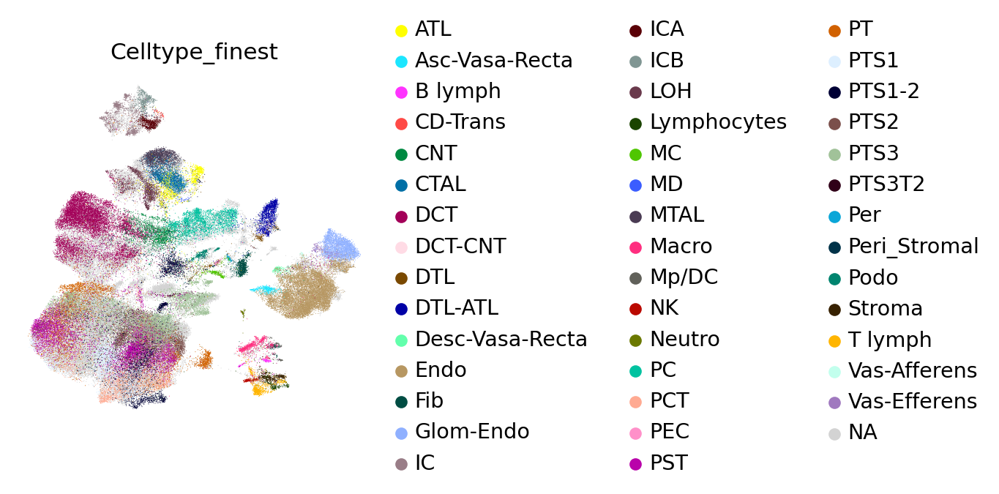

In [8]:
integrated_atlas.obs['Celltype_finest'].replace({'Unknown': np.nan}, inplace=True) # So we don't plot it
sc.pl.umap(integrated_atlas, color='Celltype_finest', save="Celltype_finest_SCVI_Full.svg")
integrated_atlas.obs['Celltype_finest'].replace({np.nan:'Unknown'}, inplace=True) 

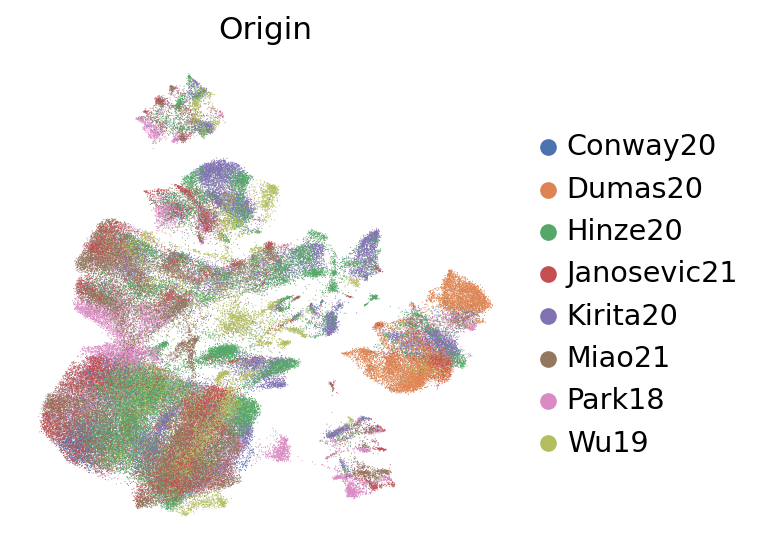

In [7]:
sc.pl.umap(integrated_atlas, color='Origin', save='Origin_SCVI_Full.svg')

In [6]:
atlas.obsm['X_umap'] = integrated_atlas.obsm['X_umap']
atlas.obsm['X_scVI'] = integrated_atlas.obsm['X_scVI']
atlas.obsm['X_scANVI'] = integrated_atlas.obsm['X_scANVI']

In [7]:
atlas.uns['Source_colors'] = sns.color_palette('tab20')
atlas.uns['Technology_colors'] = sns.color_palette('Accent')[1:4]
atlas.uns['Age_colors'] = sns.color_palette('Set2')
atlas.uns['Tissue_res_colors'] = sns.color_palette('Set3')
atlas.uns['Origin_colors'] = MY_PALETTES['deep']

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or R

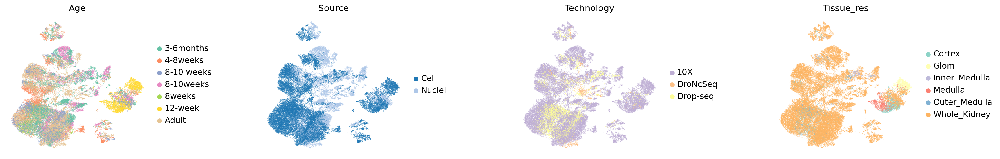

In [14]:
sc.pl.umap(atlas, color=['Age', 'Source', 'Technology', 'Tissue_res'], wspace=0.6, save='Metadata_SCVI_Full.svg')

### Latent Space (kNN)

In [8]:
ref_scHPL = integrated_atlas[(integrated_atlas.obs['Origin'].isin(['Kirita20', 'Park18', 'Wu19', 'Miao21', 'Dumas20', 'Janosevic21'])) & (integrated_atlas.obs.Celltype_finest != 'Unknown')]

In [9]:
query_scHPL = integrated_atlas[(integrated_atlas.obs.Celltype_finest == 'Unknown') | (integrated_atlas.obs.Origin.isin(['Hinze20', 'Conway20']))].copy()

In [10]:
query_scHPL

AnnData object with n_obs × n_vars = 58691 × 3000
    obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
    uns: 'Celltype_finest_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [11]:
ref_scHPL

View of AnnData object with n_obs × n_vars = 82710 × 3000
    obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
    uns: 'Celltype_finest_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [12]:
assert ref_scHPL.shape[0] + query_scHPL.shape[0] == integrated_atlas.shape[0] # make sure we split the data correctly and we are not missing any cells

In [13]:
ref_scHPL.obs['Celltype_finest_scHPL'] = ref_scHPL.obs[['Celltype_finest', 'Origin']].apply(lambda x: x.str.cat(sep='-'), axis=1)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


In [14]:
# store latent repr in own anndata object

ref_scHPL_X_scANVI = sc.AnnData(ref_scHPL.obsm['X_scANVI'])
ref_scHPL_X_scANVI.obs['Origin'] = ref_scHPL.obs['Origin'].to_list()
ref_scHPL_X_scANVI.obs['Celltype_finest_scHPL'] = ref_scHPL.obs['Celltype_finest_scHPL'].to_list()

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Starting tree:


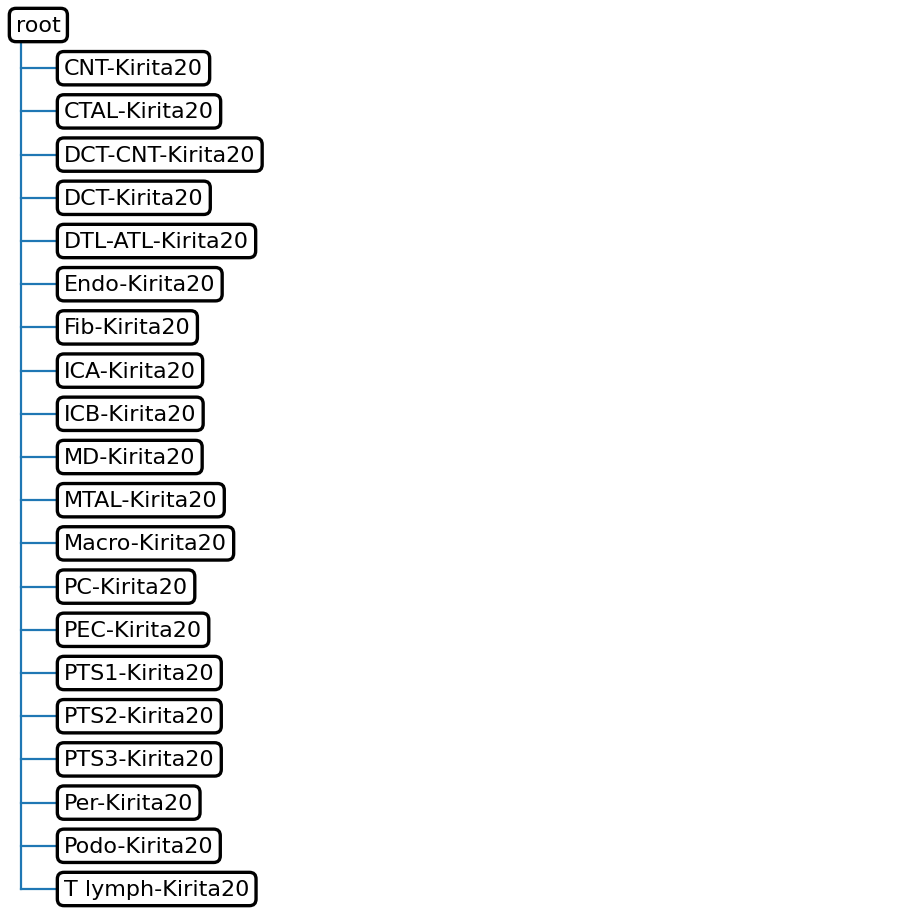


Adding dataset Wu19 to the tree

Updated tree:


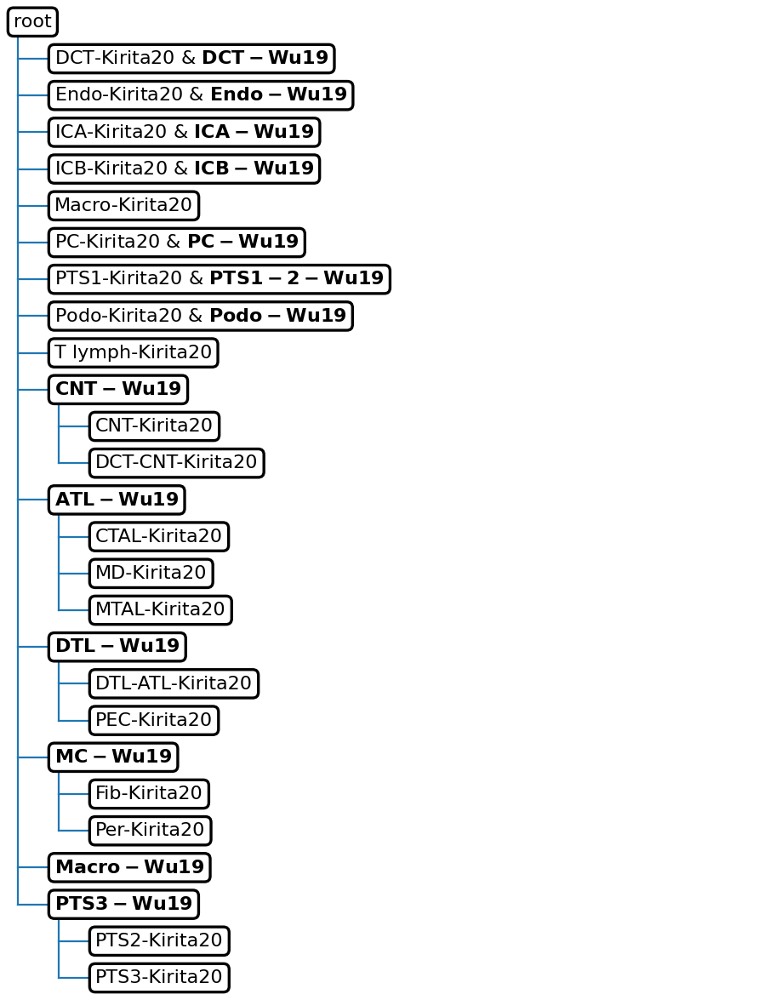


Adding dataset Miao21 to the tree
These populations are missing from the tree: 
['PCT-Miao21' 'PST-Miao21']

Updated tree:


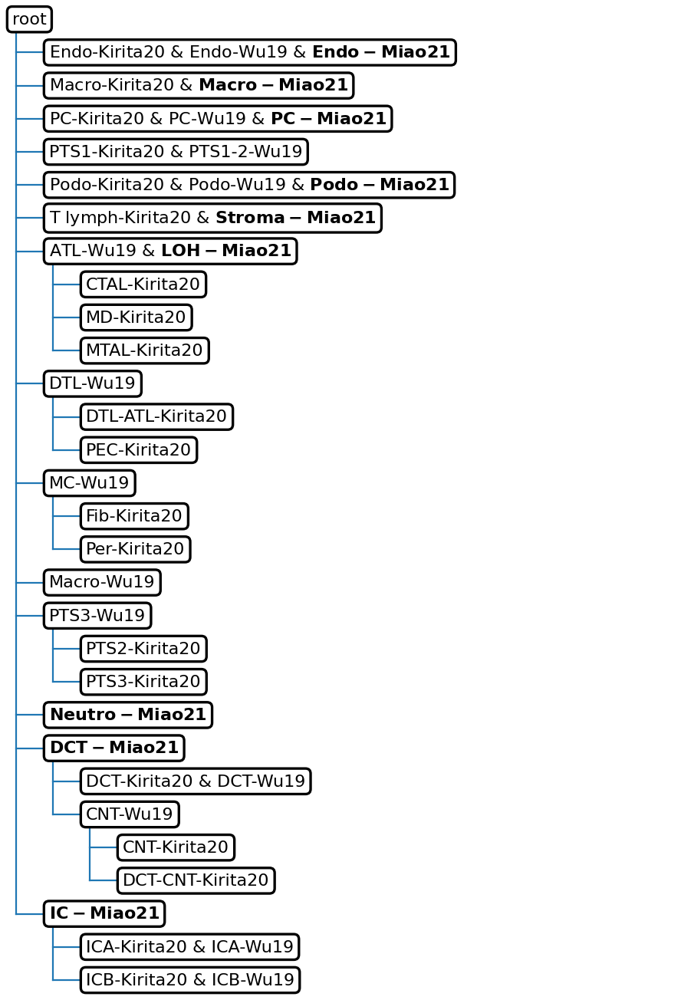


Adding dataset Janosevic21 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


These populations are missing from the tree: 
['PTS2-Janosevic21']

Updated tree:


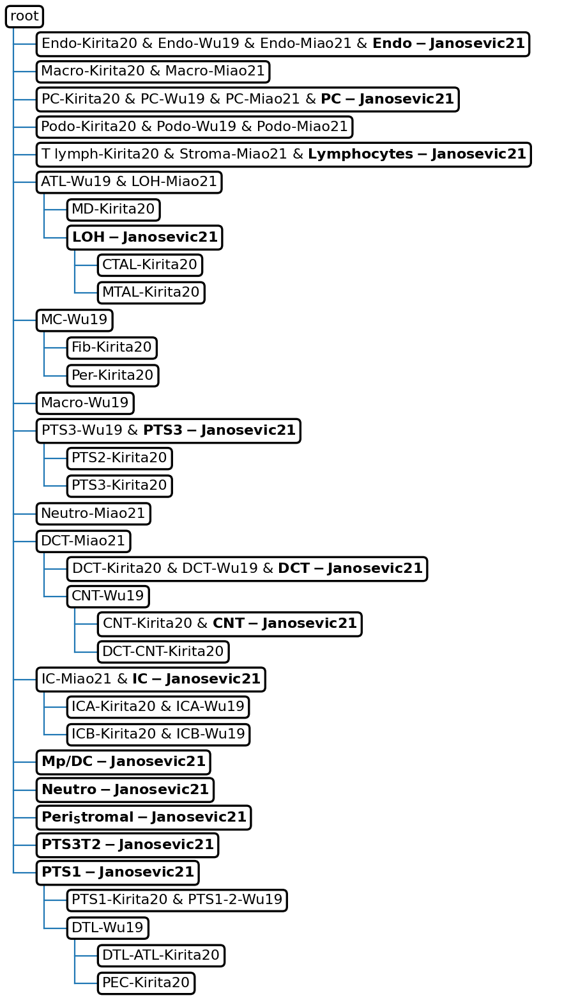


Adding dataset Park18 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


These populations are missing from the tree: 
['PT-Park18']

Updated tree:


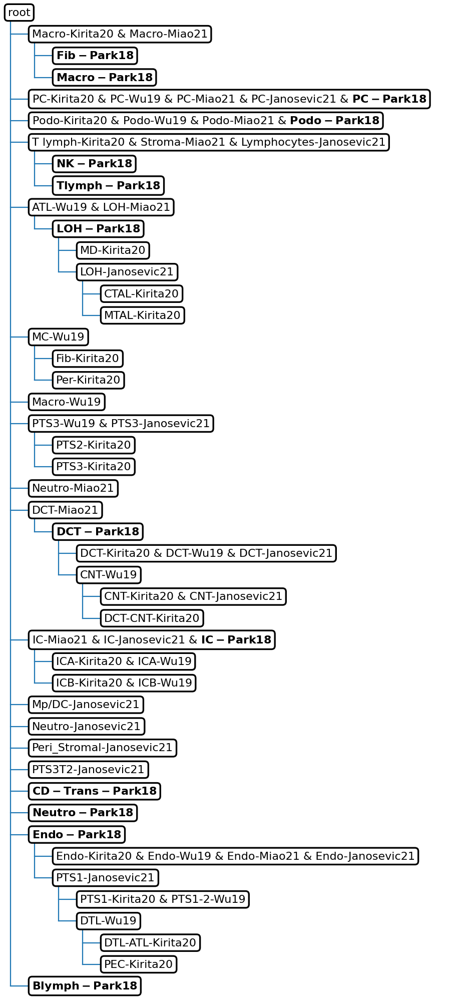


Adding dataset Dumas20 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)



Updated tree:


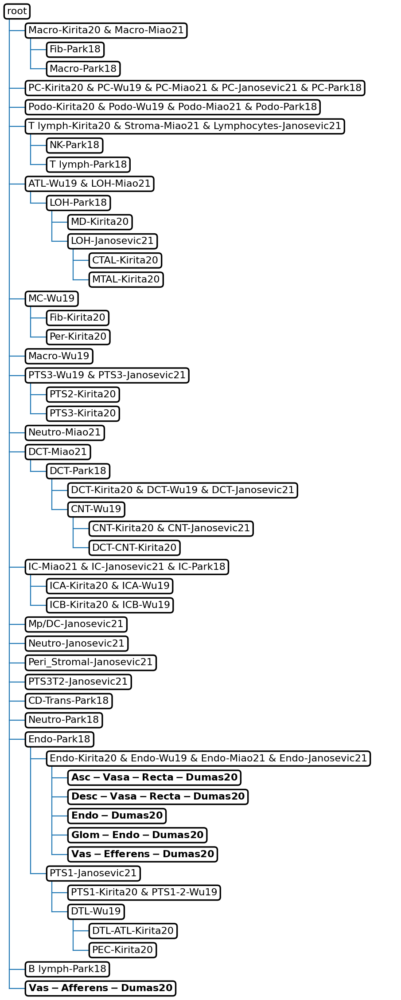

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


In [62]:
tree_ref, mp_ref = learn.learn_tree(data = ref_scHPL_X_scANVI , 
                batch_key = 'Origin',
                batch_order = ['Kirita20', 'Wu19', 'Miao21', 'Janosevic21', 'Park18', 'Dumas20'],
                cell_type_key='Celltype_finest_scHPL',
                classifier = 'knn')

### Latent Space (SVM)

In [315]:
groups = integrated_atlas.obs.groupby('Origin').indices

In [316]:
Kirita = integrated_atlas[groups['Kirita20']]
Kirita.obs['Celltype_Kirita'] = Kirita.obs['Celltype_Kirita'].astype(str) + '-Kirita'
Park = integrated_atlas[groups['Park18']]
Park_unknown = Park[Park.obs['Celltype_Park'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Park = Park[Park.obs.index.difference(Park_unknown)]
Park.obs['Celltype_Park'] = Park.obs['Celltype_Park'].astype(str) + '-Park'
Wu = integrated_atlas[groups['Wu19']]
Wu.obs['Celltype_Wu'] = Wu.obs['Celltype_Wu'].astype(str) + '-Wu'
Miao = integrated_atlas[groups['Miao21']]
Miao_unknown = Miao[Miao.obs['Celltype_Susztak'] == 'Unknown'].obs.index
Miao = Miao[Miao.obs.index.difference(Miao_unknown)]
Miao.obs['Celltype_Susztak'] = Miao.obs['Celltype_Susztak'].astype(str) + '-Miao'
Dumas = integrated_atlas[groups['Dumas20']]
Dumas_unknown = Dumas[Dumas.obs['Celltype_Dumas'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Dumas = Dumas[Dumas.obs.index.difference(Dumas_unknown)]
Dumas.obs['Celltype_Dumas'] = Dumas.obs['Celltype_Dumas'].astype(str) + '-Dumas'
Janosevic = integrated_atlas[groups['Janosevic21']]
Janosevic_unknown = Janosevic[Janosevic.obs['Celltype_Janosevic'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Janosevic = Janosevic[Janosevic.obs.index.difference(Janosevic_unknown)]
Janosevic.obs['Celltype_Janosevic'] = Janosevic.obs['Celltype_Janosevic'].astype(str) + '-Janosevic'

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:6: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:8: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:12: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  if sys.path[0] == '':
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:16: ImplicitModificationWarnin

In [317]:
test_groups = integrated_atlas[integrated_atlas.obs['Origin'].isin(['Conway20','Hinze20', 'Park18', 'Miao21', 'Janosevic21'])]
test_groups_known_park = test_groups[test_groups.obs['Celltype_Park'] != 'Unknown'].obs.index
test_groups = test_groups[test_groups.obs.index.difference(test_groups_known_park)]
test_groups_known_Miao = test_groups[test_groups.obs['Celltype_Susztak'] != 'Unknown'].obs.index
test_groups = test_groups[test_groups.obs.index.difference(test_groups_known_Miao)]
test_groups_known_dumas = test_groups[test_groups.obs['Celltype_Dumas'] != 'Unknown'].obs.index
test_groups = test_groups[test_groups.obs.index.difference(test_groups_known_dumas)]
test_groups_known_janosevic = test_groups[test_groups.obs['Celltype_Janosevic'] != 'Unknown'].obs.index
test_groups = test_groups[test_groups.obs.index.difference(test_groups_known_janosevic)]

In [318]:
test_groups

View of AnnData object with n_obs × n_vars = 58691 × 3000
    obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
    uns: 'Celltype_finest_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

We order the datasets in the following order for scHPL to learn: Kirita - Wu - Janosevic - Dumas - Park - Miao

In [319]:
data = []
labels = []

data.append(pd.DataFrame(data = Kirita.obsm['X_scANVI'], index = Kirita.obs_names))
labels.append(pd.DataFrame(data = Kirita.obs['Celltype_Kirita'].values))

data.append(pd.DataFrame(data = Wu.obsm['X_scANVI'], index = Wu.obs_names))
labels.append(pd.DataFrame(data = Wu.obs['Celltype_Wu'].values))

data.append(pd.DataFrame(data = Janosevic.obsm['X_scANVI'], index = Janosevic.obs_names))
labels.append(pd.DataFrame(data = Janosevic.obs['Celltype_Janosevic'].values))

data.append(pd.DataFrame(data = Park.obsm['X_scANVI'], index = Park.obs_names))
labels.append(pd.DataFrame(data = Park.obs['Celltype_Park'].values))

data.append(pd.DataFrame(data = Miao.obsm['X_scANVI'], index = Miao.obs_names))
labels.append(pd.DataFrame(data = Miao.obs['Celltype_Susztak'].values))

data.append(pd.DataFrame(data = Dumas.obsm['X_scANVI'], index = Dumas.obs_names))
labels.append(pd.DataFrame(data = Dumas.obs['Celltype_Dumas'].values))

testdata = pd.DataFrame(data = test_groups.obsm['X_scANVI'].toarray(), index = test_groups.obs_names)

In [320]:
assert sum(len(i) for i in data) + len(test_groups) == len(atlas) #Make sure we don't leave any test / train data behind

In [321]:
import time as tm
import os
from sklearn.model_selection import train_test_split, StratifiedKFold
from scHPL import train, predict, update, progressive_learning, utils, evaluate
from contextlib import redirect_stdout

In [41]:
## Train progressive learning tree_occ

threshold = 0.25
classifier = 'svm'
dimred = False
tree_occ = progressive_learning.learn_tree(
    data, labels, classifier=classifier, dimred=dimred, threshold=threshold)

Iteration  1 

Perfect match:  DCT-Wu is now: DCT-Kirita
Perfect match:  Endo-Wu is now: Endo-Kirita
Perfect match:  ICA-Wu is now: ICA-Kirita
Perfect match:  ICB-Wu is now: ICB-Kirita
Perfect match:  Macro-Wu is now: Macro-Kirita
Perfect match:  PC-Wu is now: PC-Kirita
Perfect match:  Podo-Wu is now: Podo-Kirita
Perfect match:  PTS1-2-Wu is now: PTS1-Kirita

Updated tree:
root
	DCT-Kirita
	Endo-Kirita
	ICA-Kirita
	ICB-Kirita
	Macro-Kirita
	PC-Kirita
	PTS1-Kirita
	Podo-Kirita
	T lymph-Kirita
	CNT-Wu
		CNT-Kirita
		DCT-CNT-Kirita
	ATL-Wu
		CTAL-Kirita
		MD-Kirita
		MTAL-Kirita
	DTL-Wu
		DTL-ATL-Kirita
		PEC-Kirita
	MC-Wu
		Fib-Kirita
		Per-Kirita
	PTS3-Wu
		PTS2-Kirita
		PTS3-Kirita
Iteration  2 



/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


Perfect match:  Endo-Janosevic is now: Endo-Kirita
Perfect match:  PC-Janosevic is now: PC-Kirita
Perfect match:  Peri_Stromal-Janosevic is now: PEC-Kirita
Perfect match:  Lymphocytes-Janosevic is now: T lymph-Kirita
Perfect match:  DCT-Janosevic is now: DCT-Kirita
Perfect match:  PTS3-Janosevic is now: PTS2-Kirita

Updated tree:
root
	DCT-Kirita
	Endo-Kirita
	Macro-Kirita
	PC-Kirita
	PTS1-Kirita
		PTS1-Janosevic
	Podo-Kirita
	T lymph-Kirita
	CNT-Wu
		CNT-Kirita
			CNT-Janosevic
		DCT-CNT-Kirita
	DTL-Wu
		DTL-ATL-Kirita
		PEC-Kirita
	MC-Wu
		Fib-Kirita
		Per-Kirita
	PTS3-Wu
		PTS2-Kirita
		PTS3-Kirita
			PTS3T2-Janosevic
	LOH-Janosevic
		ATL-Wu
			CTAL-Kirita
			MD-Kirita
			MTAL-Kirita
	IC-Janosevic
		ICA-Kirita
		ICB-Kirita
	Mp/DC-Janosevic
	Neutro-Janosevic
	PTS2-Janosevic
Iteration  3 



/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


Perfect match:  LOH-Park is now: ATL-Wu
Perfect match:  IC-Park is now: IC-Janosevic
Perfect match:  PC-Park is now: PC-Kirita
These populations are missing from the tree: 
Index(['CD-Trans-Park'], dtype='object')

Updated tree:
root
	Macro-Kirita
		Macro-Park
	PC-Kirita
	Podo-Kirita
	T lymph-Kirita
		NK-Park
		T lymph-Park
	LOH-Janosevic
		ATL-Wu
			CTAL-Kirita
			MD-Kirita
			MTAL-Kirita
	IC-Janosevic
		ICA-Kirita
		ICB-Kirita
	Mp/DC-Janosevic
	Neutro-Janosevic
	DCT-Park
		DCT-Kirita
		CNT-Wu
			CNT-Kirita
				CNT-Janosevic
			DCT-CNT-Kirita
	Endo-Park
		Endo-Kirita
		DTL-Wu
			DTL-ATL-Kirita
			PEC-Kirita
		MC-Wu
			Fib-Kirita
			Per-Kirita
	PT-Park
		PTS1-Kirita
			PTS1-Janosevic
		PTS3-Wu
			PTS2-Kirita
			PTS3-Kirita
				PTS3T2-Janosevic
		PTS2-Janosevic
	B lymph-Park
	Fib-Park
	Neutro-Park
	Podo-Park
Iteration  4 



/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


Perfect match:  Endo-Miao is now: Endo-Kirita
Perfect match:  IC-Miao is now: IC-Janosevic
Perfect match:  Stroma-Miao is now: T lymph-Kirita
Perfect match:  Neutro-Miao is now: Neutro-Janosevic
Perfect match:  PC-Miao is now: PC-Kirita
Perfect match:  PCT-Miao is now: PTS1-Kirita

Updated tree:
root
	PC-Kirita
	T lymph-Kirita
		NK-Park
		T lymph-Park
	LOH-Janosevic
		ATL-Wu
			MD-Kirita
			LOH-Miao
				CTAL-Kirita
				MTAL-Kirita
	IC-Janosevic
		ICA-Kirita
		ICB-Kirita
	Mp/DC-Janosevic
	Neutro-Janosevic
	DCT-Park
		DCT-Miao
			DCT-Kirita
			CNT-Wu
				CNT-Kirita
					CNT-Janosevic
				DCT-CNT-Kirita
	Endo-Park
		Endo-Kirita
		DTL-Wu
			DTL-ATL-Kirita
			PEC-Kirita
		MC-Wu
			Fib-Kirita
			Per-Kirita
	PT-Park
		PST-Miao
			PTS1-Kirita
				PTS1-Janosevic
			PTS3-Wu
				PTS2-Kirita
				PTS3-Kirita
					PTS3T2-Janosevic
			PTS2-Janosevic
	B lymph-Park
	Neutro-Park
	Macro-Miao
		Macro-Kirita
			Macro-Park
		Fib-Park
	Podo-Miao
		Podo-Kirita
		Podo-Park
Iteration  5 


Updated tree:
root
	P

In [43]:
with open("../trees/atlas_tree_SCVI_Kirita_Wu_Janosevic_Park_Miao_Dumas.txt", "w+") as text_file:
    with redirect_stdout(text_file):
        utils.print_tree(tree_occ)

## Manual Annotation

Let's first normalize and scale counts for plotting. Let's exclude highly expressed genes from size factors

In [15]:
normalized = sc.read_h5ad("/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_full_normalized.h5ad")

In [16]:
atlas.X = normalized.X.copy()
integrated_atlas.X = normalized[:, list(integrated_atlas.var_names)].X.copy()

del normalized

#### The structure of adata is the following:
 - (cells x full feature space)
 - adata.X: log normalized counts
 - adata.layers[counts]: raw counts
 - adata.raw: None
 
#### The structure of integrated_atlas is the following:
 - (cells x 3000 HVGs)
 - adata.X: log normalized counts
 - adata.layers[counts]: raw counts
 - adata.raw: (cells x full feature space)

In [17]:
groups = integrated_atlas.obs.groupby('Origin').indices

In [18]:
Kirita_int = integrated_atlas[groups['Kirita20']]
Kirita_unknown = Kirita_int[Kirita_int.obs['Celltype_Kirita'] == 'Unknown']
Kirita = atlas[groups['Kirita20']]
Wu_int = integrated_atlas[groups['Wu19']]
Wu_unknown = Wu_int[Wu_int.obs['Celltype_Wu'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Wu_int = Wu_int[Wu_int.obs.index.difference(Wu_unknown)]
Wu = atlas[groups['Wu19']]
Miao_int = integrated_atlas[groups['Miao21']]
Miao_unknown = Miao_int[Miao_int.obs['Celltype_Susztak'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Miao_int = Miao_int[Miao_int.obs.index.difference(Miao_unknown)]
Miao = atlas[groups['Miao21']]
Park_int = integrated_atlas[groups['Park18']]
Park_unknown = Park_int[Park_int.obs['Celltype_Park'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Park_int = Park_int[Park_int.obs.index.difference(Park_unknown)]
Park = atlas[groups['Park18']]
Dumas_int = integrated_atlas[groups['Dumas20']]
Dumas_unknown = Dumas_int[Dumas_int.obs['Celltype_Dumas'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Dumas_int = Dumas_int[Dumas_int.obs.index.difference(Dumas_unknown)]
Dumas = atlas[groups['Dumas20']]
Janosevic_int = integrated_atlas[groups['Janosevic21']]
Janosevic_unknown = Janosevic_int[Janosevic_int.obs['Celltype_Janosevic'] == 'Unknown'].obs.index ##Keep only cells with known celltpe
Janosevic_int = Janosevic_int[Janosevic_int.obs.index.difference(Janosevic_unknown)]
Janosevic = atlas[groups['Janosevic21']]

### IC

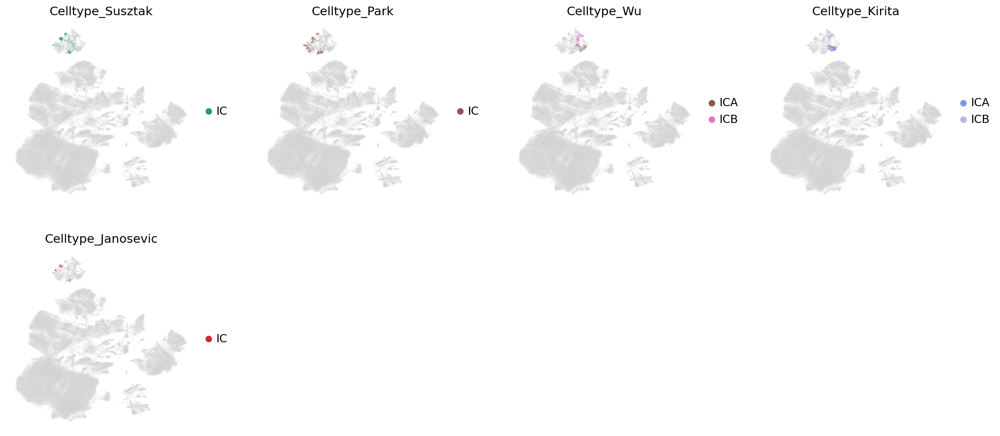

In [72]:
sc.pl.umap(atlas, groups=['IC', 'ICA', 'ICB'], color=['Celltype_Susztak', 'Celltype_Park', 'Celltype_Wu', 'Celltype_Kirita', 'Celltype_Janosevic'], na_in_legend=False, save='IC-SCVI_Full.svg')

In [19]:
IC_Miao = Miao[Miao.obs['Celltype_Susztak'] == 'IC']
IC_park = Park[Park.obs['Celltype_Park'] == 'IC']
IC_janosevic = Janosevic[Janosevic.obs['Celltype_Janosevic'] == 'IC']

In [20]:
IC = IC_Miao.concatenate(IC_park, IC_janosevic)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


Markers from: https://www.pnas.org/content/114/46/E9989/tab-figures-data and https://www.annualreviews.org/doi/abs/10.1146/annurev-physiol-052521-121841#:~:text=The%20kidney%20maintains%20electrolyte%2C%20water,types%20in%20the%20mammalian%20kidney.

In [21]:
ICA_markers = ["Atp4a", "Slc4a1", "Aqp6", "Kit", "Adgrf5", "Mme"]
ICB_markers = ["Spink8", "Insrr"]

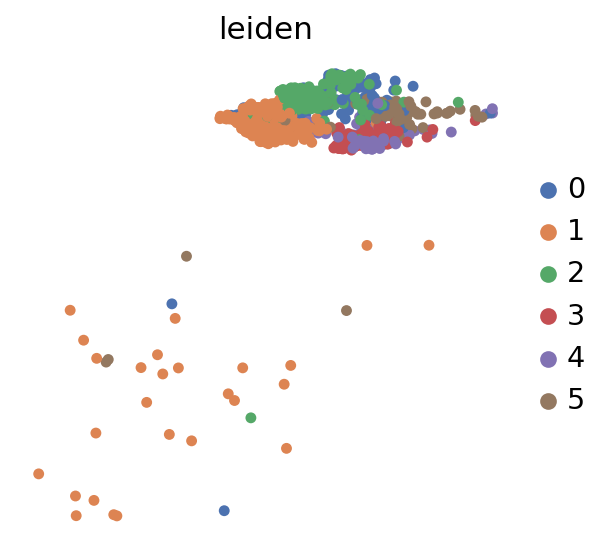

In [22]:
sc.pp.neighbors(IC, n_neighbors=10)
sc.tl.leiden(IC, resolution=0.2)
sc.pl.umap(IC, color='leiden', palette=MY_PALETTES['deep'], save='IC_leiden_SCVI_Full.svg')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


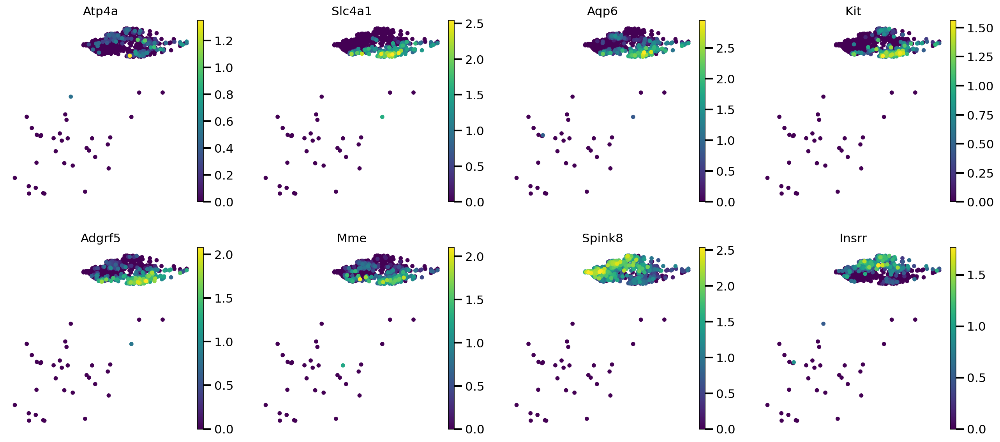

In [23]:
sc.pl.umap(IC, color = ICA_markers + ICB_markers, save='ICA_ICB_SCVI_Full.svg')

In [24]:
leiden_rename = {
    '0': 'ICA',
    '1': 'ICB',
    '2': 'ICB',
    '3': 'ICA',
    '4': 'ICA',
    '5': 'ICA'}

IC.obs['newLeiden'] = IC.obs['leiden'].replace(leiden_rename).astype('category')

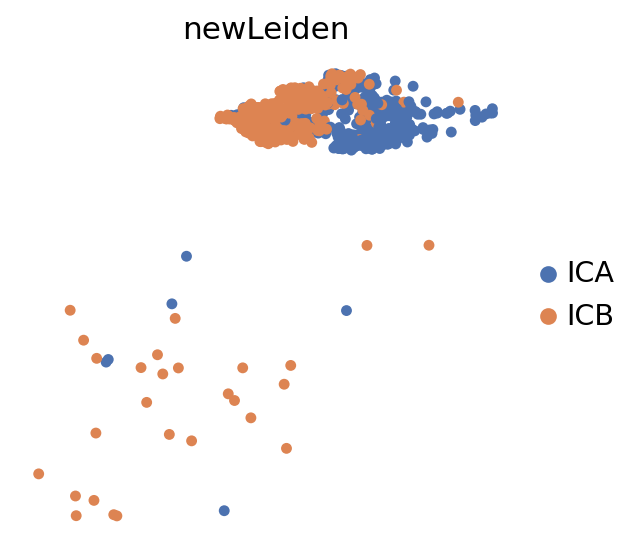

In [25]:
sc.pl.umap(IC, color='newLeiden', palette=MY_PALETTES['deep'], save='IC_leiden_resolved_SCVI_Full.svg')

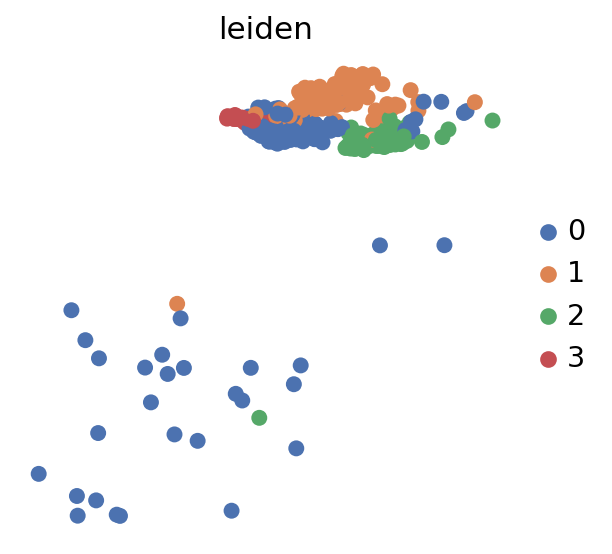

In [23]:
sc.pp.neighbors(IC_park, n_neighbors=10)
sc.tl.leiden(IC_park, resolution=0.2)
sc.pl.umap(IC_park, color='leiden', palette=MY_PALETTES['deep'], save='IC_park_leiden_SCVI_Full.svg')

In [26]:
leiden_rename = {
    '0': 'ICB',
    '1': 'ICB',
    '2': 'ICA',
    '3': 'ICB'}

IC_park.obs['newLeiden'] = IC_park.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


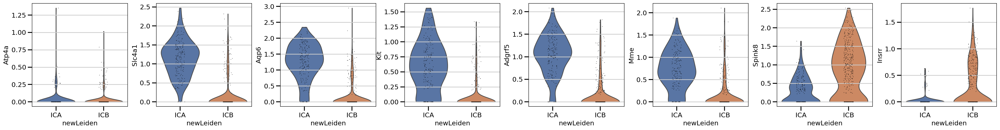

In [27]:
sc.pl.violin(IC_park, keys = ICA_markers + ICB_markers, groupby='newLeiden', palette=MY_PALETTES['deep'], save='IC_park_violin_SCVI.svg')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


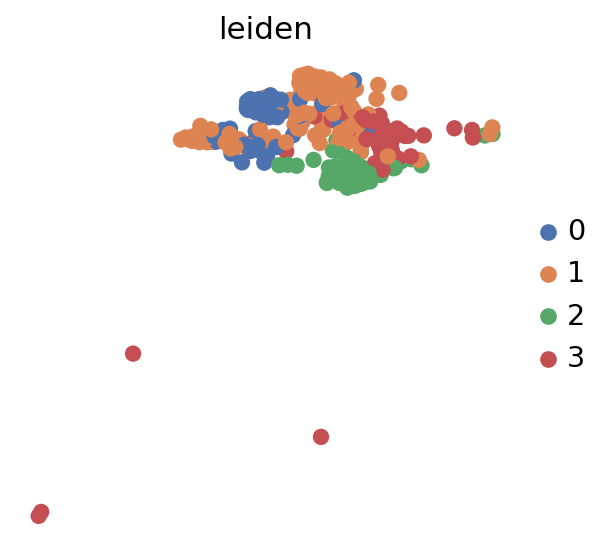

In [28]:
sc.pp.neighbors(IC_Miao, n_neighbors=10)
sc.tl.leiden(IC_Miao, resolution=0.2)
sc.pl.umap(IC_Miao, color='leiden', palette=MY_PALETTES['deep'], save='IC_Miao_leiden_SCVI.svg')

In [30]:
leiden_rename = {
    '0': 'ICB',
    '1': 'ICB',
    '2': 'ICA',
    '3': 'ICA'}

IC_Miao.obs['newLeiden'] = IC_Miao.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


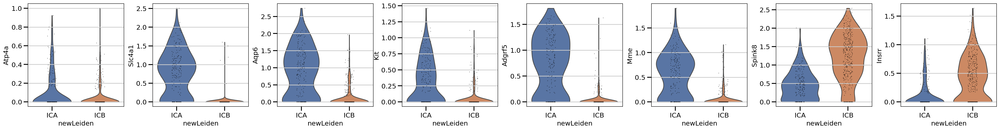

In [31]:
sc.pl.violin(IC_Miao, keys = ICA_markers + ICB_markers, groupby='newLeiden',palette=MY_PALETTES['deep'], save='IC_Miao_violin_SCVI.svg')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


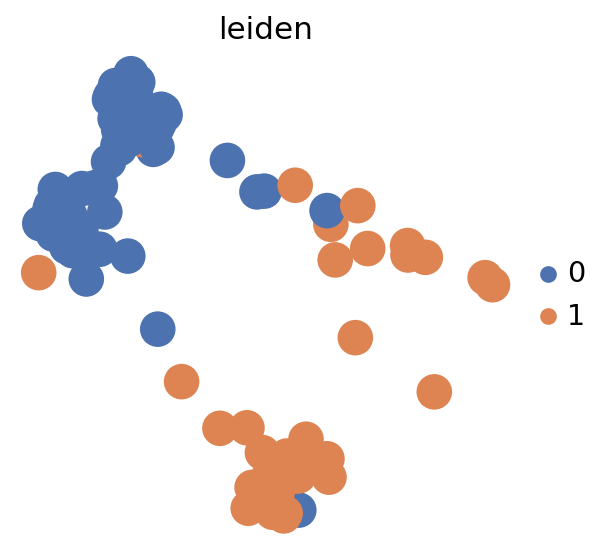

In [32]:
sc.pp.neighbors(IC_janosevic, n_neighbors=10)
sc.tl.leiden(IC_janosevic, resolution=0.2)
sc.pl.umap(IC_janosevic, color='leiden', palette=MY_PALETTES['deep'],  save='IC_janosevic_leiden_SCVI.svg')

In [34]:
leiden_rename = {
    '0': 'ICB',
    '1': 'ICA'}

IC_janosevic.obs['newLeiden'] = IC_janosevic.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


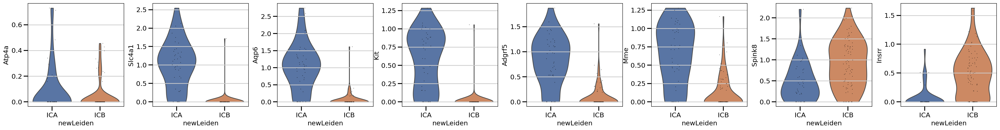

In [35]:
sc.pl.violin(IC_janosevic, keys = ICA_markers + ICB_markers, palette=MY_PALETTES['deep'], groupby='newLeiden', save='IC_janosevic_violin_SCVI.svg')

In [36]:
Miao_int.obs['Celltype_Susztak'] = Miao_int.obs['Celltype_Susztak'].astype('category')
integrated_atlas.obs['Celltype_Susztak'] = integrated_atlas.obs['Celltype_Susztak'].astype('category')
Park_int.obs['Celltype_Park'] = Park_int.obs['Celltype_Park'].astype('category')
integrated_atlas.obs['Celltype_Park'] = integrated_atlas.obs['Celltype_Park'].astype('category')
Janosevic_int.obs['Celltype_Janosevic'] = Janosevic_int.obs['Celltype_Janosevic'].astype('category')
integrated_atlas.obs['Celltype_Janosevic'] = integrated_atlas.obs['Celltype_Janosevic'].astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  This is separate from the ipykernel package so we can avoid doing imports until
/exports/humgen/cnovellarausell/conda_envs/atlas_work/l

In [37]:
Park_int.obs['Celltype_Park'].cat.add_categories(['ICA', 'ICB', 'Unknown'], inplace=True)
Miao_int.obs['Celltype_Susztak'].cat.add_categories(['ICA', 'ICB', 'Unknown'], inplace=True)
Janosevic_int.obs['Celltype_Janosevic'].cat.add_categories(['ICA', 'ICB', 'Unknown'], inplace=True)

integrated_atlas.obs['Celltype_Park'].cat.add_categories(['ICA', 'ICB'], inplace=True)
integrated_atlas.obs['Celltype_Susztak'].cat.add_categories(['ICA', 'ICB'], inplace=True)
integrated_atlas.obs['Celltype_Janosevic'].cat.add_categories(['ICA', 'ICB'], inplace=True)


new_ct = ['ICA', 'ICB', 'Unknown']
for ct in new_ct:
    Park_int.obs['Celltype_Park'].loc[IC_park[IC_park.obs['newLeiden'] == ct].obs.index] = ct
    Miao_int.obs['Celltype_Susztak'].loc[IC_Miao[IC_Miao.obs['newLeiden'] == ct].obs.index] = ct
    Janosevic_int.obs['Celltype_Janosevic'].loc[IC_janosevic[IC_janosevic.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Park'].loc[IC_park[IC_park.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Susztak'].loc[IC_Miao[IC_Miao.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Janosevic'].loc[IC_janosevic[IC_janosevic.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[IC_park[IC_park.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[IC_Miao[IC_Miao.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[IC_janosevic[IC_janosevic.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[IC_park[IC_park.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[IC_Miao[IC_Miao.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[IC_janosevic[IC_janosevic.obs['newLeiden'] == ct].obs.index] = ct

### Stroma

Stroma cells is a broad term, and T lymphocytes appear similar to them

In [38]:
from sklearn.metrics import pairwise_distances
import anndata 

stroma_susztak = anndata.AnnData(X=Miao.X, obs=Miao.obs, var=Miao.var)
tlymph_park = anndata.AnnData(X=Park.X, obs=Park.obs, var=Park.var)

In [39]:
import math
# Calculate mean expression per cell type
stroma_susztak_means = groupby_mean(stroma_susztak, "Celltype_Susztak")
tlymph_park_means = groupby_mean(tlymph_park, "Celltype_Park")

# Correlation distance between celltypes
corr_mtx = pd.DataFrame(
    1-pairwise_distances(stroma_susztak_means, tlymph_park_means, metric="correlation"),
    index= stroma_susztak_means.index,
    columns=tlymph_park_means.index
)

In [40]:
corr_mtx

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


,B lymph,CD-Trans,DCT,Endo,Fib,IC,LOH,Macro,NK,Neutro,PC,PT,Podo,T lymph,Unknown
DCT,0.634030,0.851262,0.956134,0.706810,0.609472,0.864069,0.904679,0.584346,0.580500,0.563998,0.836025,0.783552,0.606214,0.596118,0.867398
Endo,0.742287,0.728447,0.709713,0.917809,0.728841,0.716402,0.722281,0.695808,0.703810,0.628584,0.744499,0.716513,0.658914,0.732081,0.713894
IC,0.677694,0.927579,0.875625,0.747391,0.663240,0.955742,0.869275,0.623023,0.636821,0.603173,0.852213,0.801209,0.647461,0.650700,0.836960
LOH,0.712808,0.848780,0.901370,0.762792,0.681445,0.861728,0.945607,0.648378,0.651520,0.602035,0.846034,0.801912,0.646210,0.681755,0.848068
Macro,0.899203,0.680009,0.647618,0.777099,0.933839,0.678417,0.678645,0.877525,0.829905,0.722231,0.719699,0.693946,0.623442,0.872009,0.660923
Neutro,0.643699,0.623196,0.625851,0.659117,0.724905,0.628614,0.624439,0.639217,0.659505,0.893735,0.646770,0.637864,0.555817,0.656724,0.642420
PC,0.674791,0.904478,0.869474,0.738511,0.654035,0.833927,0.838843,0.627916,0.626606,0.602573,0.938284,0.747701,0.647583,0.645355,0.812557
PCT,0.703875,0.760778,0.799421,0.744687,0.664996,0.785620,0.795201,0.665427,0.627116,0.610114,0.765265,0.910700,0.615174,0.661077,0.860110
PST,0.743793,0.746597,0.796110,0.754326,0.706090,0.794849,0.800373,0.677156,0.663193,0.619835,0.762995,0.928757,0.614672,0.707106,0.851492
Podo,0.690780,0.711804,0.695400,0.754193,0.691158,0.709485,0.707140,0.647399,0.680520,0.615656,0.742032,0.688025,0.885581,0.691096,0.680789


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


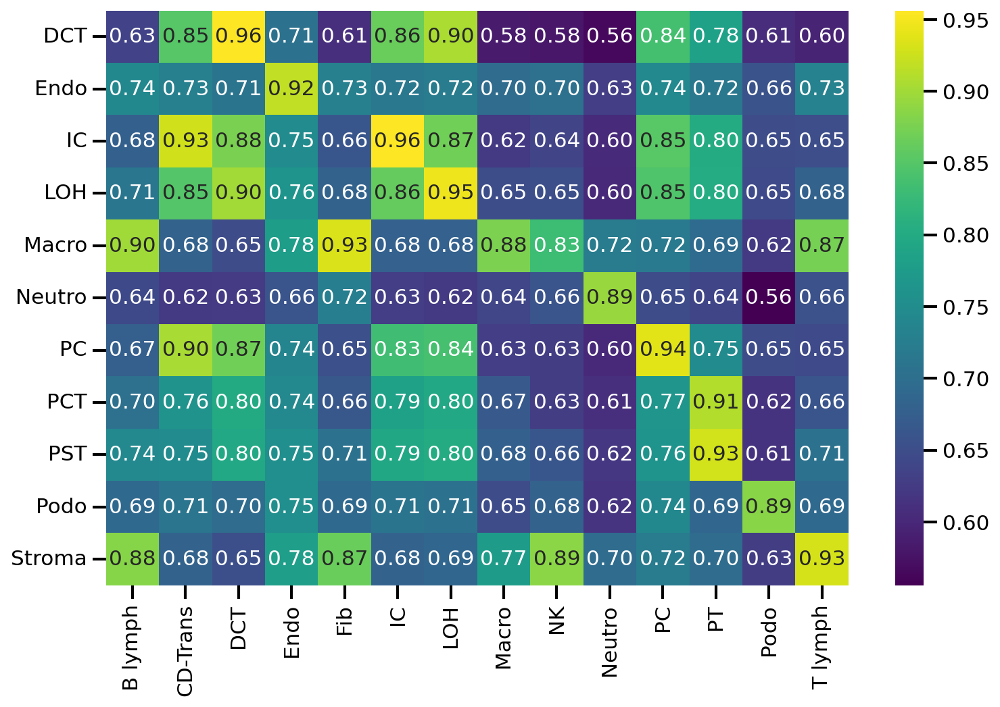

In [41]:
plt.subplots(figsize=(11,7))
sns.heatmap(corr_mtx.drop("Unknown", axis=1).drop("Unknown", axis=0), cmap='viridis', annot=True, fmt=".2f")
plt.savefig('corr_plot_SCVI_Full.pdf', format='pdf', bbox_inches='tight')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


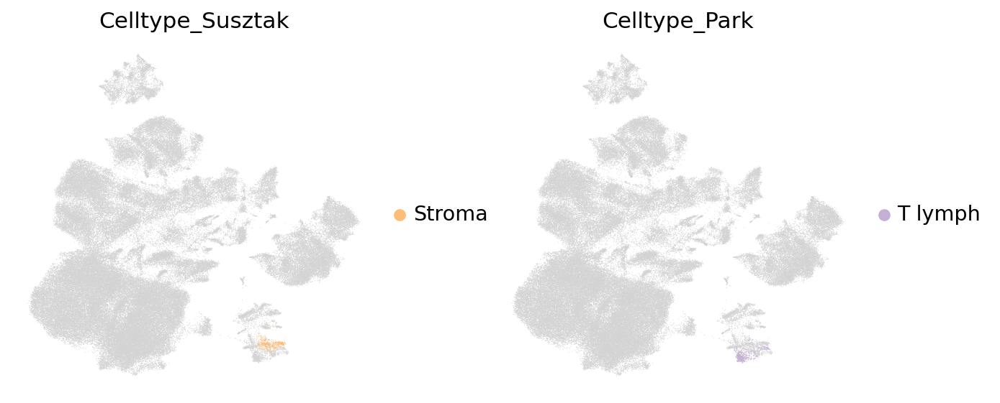

In [42]:
sc.pl.umap(atlas, groups=['Stroma', 'T lymph'], color=['Celltype_Susztak', 'Celltype_Park'], na_in_legend=False, save='Stroma_SCVI_Full.svg')

In [43]:
Stroma = Miao[Miao.obs['Celltype_Susztak'] == 'Stroma']

In [44]:
Positive_Control = Park[Park.obs['Celltype_Park'] == 'T lymph']

In [45]:
Negative_Control = Kirita[Kirita.obs['Celltype_Kirita'] != 'T lymph']

Plotting some T cell markers from https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7466803/ and  https://www.proteinatlas.org/ENSG00000168542-COL3A1/celltype/kidney

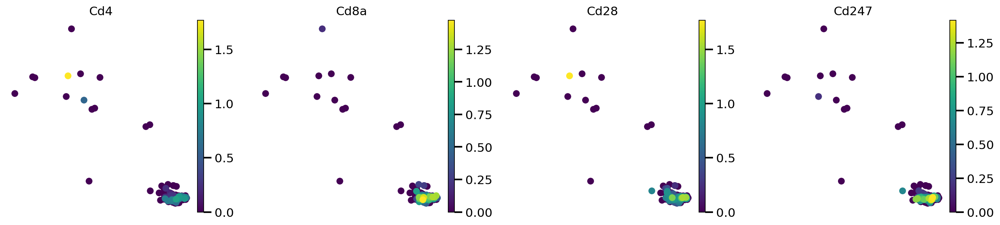

In [46]:
sc.pl.umap(Stroma, color = ['Cd4', 'Cd8a', 'Cd28', 'Cd247'], save='Stroma-Tcellmarkers_SCVI_Full.svg')

In [47]:
stroma_exp = Stroma.concatenate(Positive_Control, Negative_Control)
stroma_exp.obs['batch'] = stroma_exp.obs['batch'].replace({'0': 'Susztak Stroma cells', '1': 'Park T lymphocytes', '2': 'Kirita all cells'}).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/pandas/plotting/_matplotlib/tools.py:331: MatplotlibDeprecationWarning: 
The is_first_col function was deprecated in Matplotlib 3.4 and will be removed two minor releases later. Use ax.get_subplotspec().is_first_col() instead.
  if ax.is_first_col():


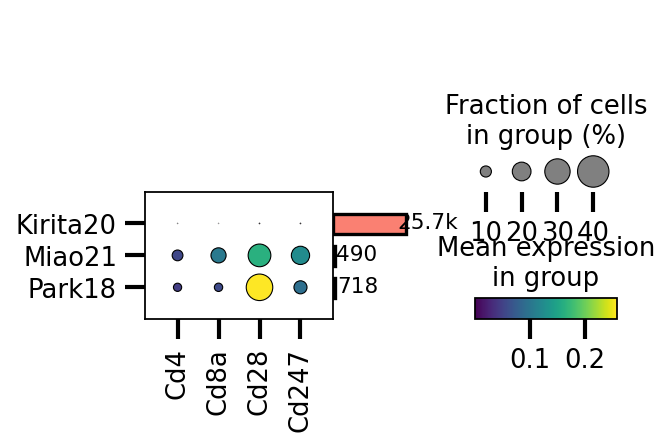

In [48]:
dp = sc.pl.dotplot(stroma_exp,['Cd4', 'Cd8a', 'Cd28', 'Cd247'], groupby='Origin', return_fig=True)
dp.add_totals().style( dot_edge_color='black', dot_edge_lw=0.5, cmap='viridis').savefig('tlymph-stroma-dotplot_SCVI_Full.svg')

In [49]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
Miao_int.obs['Celltype_Susztak'].cat.add_categories(['T lymph'], inplace=True)

Miao_int.obs['Celltype_Susztak'].loc[Miao_int[Miao_int.obs['Celltype_Susztak'] == 'Stroma'].obs.index] = 'T lymph'
atlas.obs['Celltype_finest'].loc[atlas[atlas.obs['Celltype_finest'] == 'Stroma'].obs.index] = 'T lymph'
integrated_atlas.obs['Celltype_finest'].loc[integrated_atlas[integrated_atlas.obs['Celltype_finest'] == 'Stroma'].obs.index] = 'T lymph'

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Fibroblasts

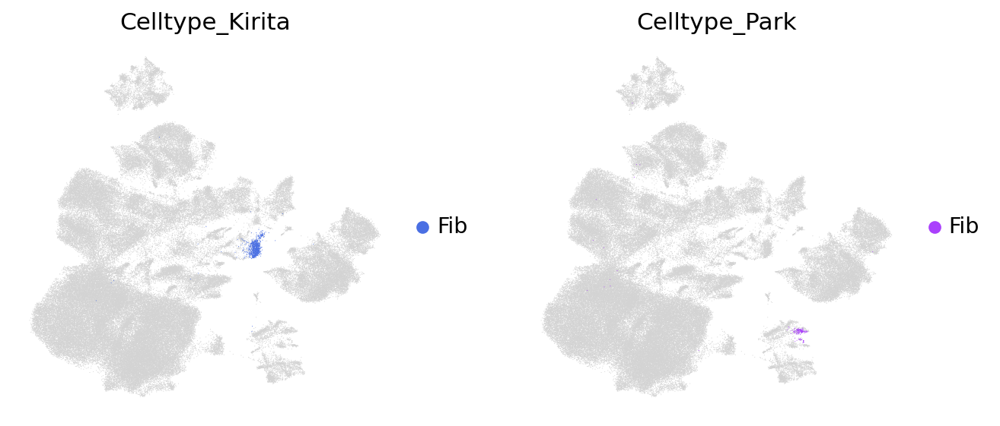

In [50]:
sc.pl.umap(atlas, groups=['Fib'], color=['Celltype_Kirita', 'Celltype_Park'], na_in_legend=False, save='Fibroblast_SCVI_Full.svg')

We can already see that some of the Fibroblasts map together with Macrophages. We can subcluster the Fib population to see if one of the populations shares markers with PT cells

In [51]:
fib_park = Park[Park.obs['Celltype_Park'] == 'Fib']

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


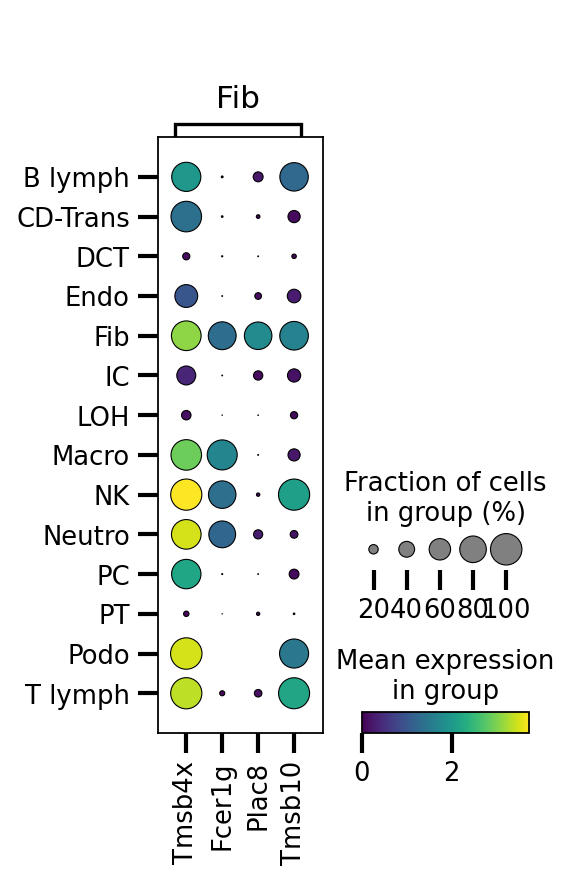

In [52]:
Park.obs['Celltype_Park'].replace({'Unknown': np.nan}, inplace=True) # So we don't plot it
sc.tl.rank_genes_groups(Park, 'Celltype_Park', method='wilcoxon', use_raw=False)
dp = sc.pl.rank_genes_groups_dotplot(Park, n_genes=4, groups=['Fib'], return_fig=True, dendrogram=False)
dp.style( dot_edge_color='black', dot_edge_lw=0.5, cmap='viridis').savefig('fib-park_SCVI_Full.svg')
Park.obs['Celltype_Park'].replace({np.nan: 'Unknown'}, inplace=True) # So we don't plot it

We see that for the Park dataset the Fibroblasts are child to Macrophages in the tree. Let's plot some Macrophage markers. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4689374 https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7466803/

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


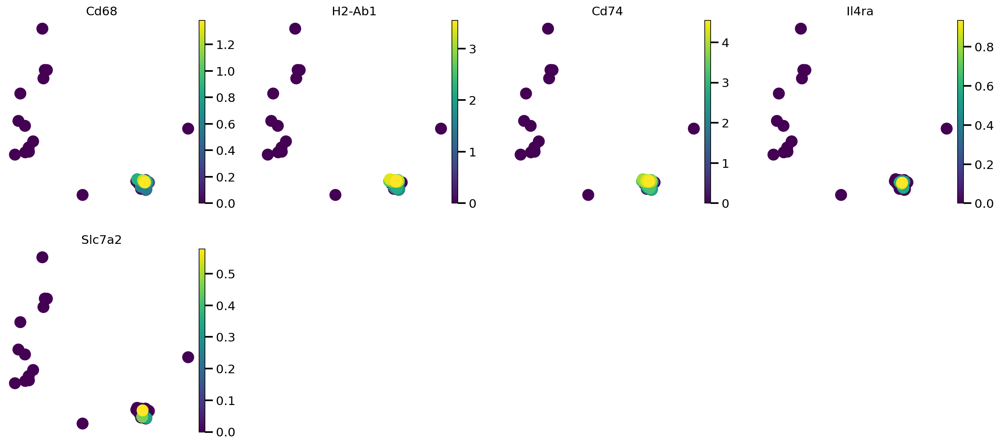

In [53]:
sc.pl.umap(fib_park, color=['Cd68', 'H2-Ab1','Cd74', 'Il4ra','Slc7a2'], save='Park-Fib-MacroMarkers_SCVI_Full.svg')

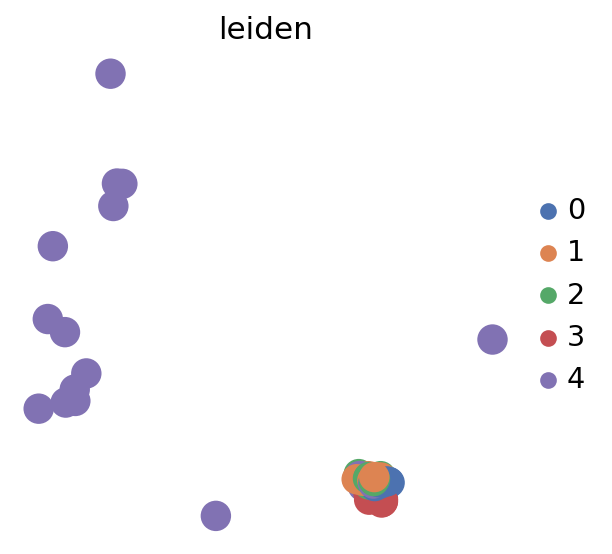

In [54]:
sc.pp.neighbors(fib_park, n_neighbors=10)
sc.tl.leiden(fib_park, resolution=0.4)
sc.pl.umap(fib_park, color='leiden',  palette=MY_PALETTES['deep'], save='fibroblast_park_leiden_SCVI_Full.svg')

In [55]:
leiden_rename = {
    '0': 'Macro',
    '1': 'Macro',
    '2': 'Macro',
    '3': 'Macro',
    '4': 'Unknown'}

fib_park.obs['newLeiden'] = fib_park.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


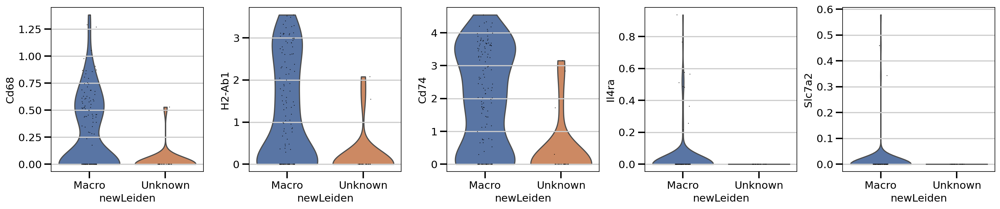

In [56]:
sc.pl.violin(fib_park, keys = ['Cd68', 'H2-Ab1', 'Cd74', 'Il4ra','Slc7a2'], groupby='newLeiden', palette=MY_PALETTES['deep'], save='park_fib_violin_SCVI_Full.svg')

<!-- We also see that some of the Kirita fibroblasts are part of two distinct sections in the umap. Let's plot some Fibroblast markers. https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7466803/
https://jasn.asnjournals.org/content/17/11/2992#T1 -->

In [57]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
# Kirita_int.obs['Celltype_Kirita'].cat.add_categories(['Unknown'], inplace=True)
#atlas.obs['Celltype_finest'].cat.add_categories(['Unknown'], inplace=True)

new_ct = ['Macro', 'Unknown']
for ct in new_ct:
    Park_int.obs['Celltype_Park'].loc[fib_park[fib_park.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Park'].loc[fib_park[fib_park.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[fib_park[fib_park.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[fib_park[fib_park.obs['newLeiden'] == ct].obs.index] = ct

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


### Park Endo DTL

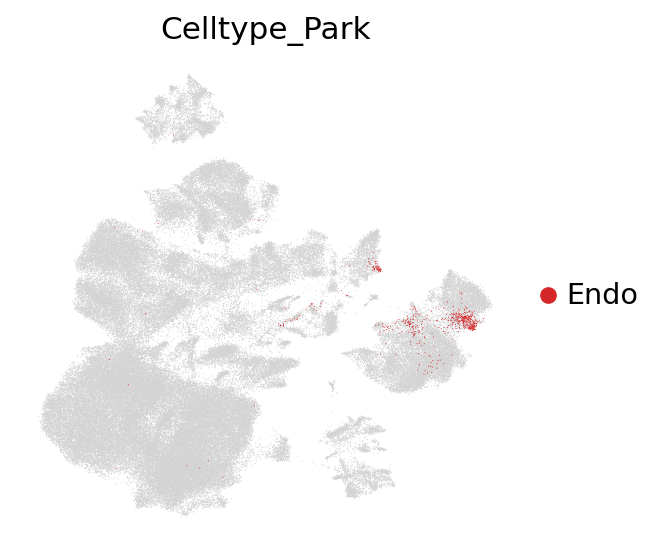

In [58]:
sc.pl.umap(atlas, groups=['Endo'], color=['Celltype_Park'], na_in_legend=False, save='endo_SCVI_Full.svg')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


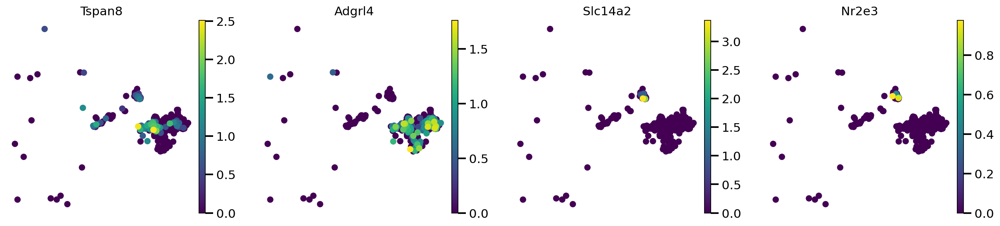

In [59]:
sc.pl.umap(Park[Park.obs['Celltype_Park'].isin(['Endo'])], color=['Tspan8', 'Adgrl4', 'Slc14a2', 'Nr2e3'], save='endo_park_full.svg') 

In [60]:
endo = Park_int[Park_int.obs['Celltype_Park'] == 'Endo']

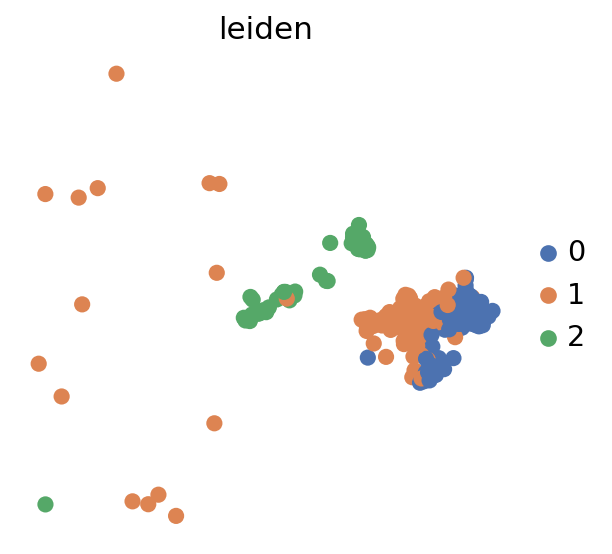

In [61]:
sc.pp.neighbors(endo, n_neighbors=10)
sc.tl.leiden(endo, resolution=0.2)
sc.pl.umap(endo, color='leiden', palette=MY_PALETTES['deep'], save='endo-park_leiden_SCVI_full.svg')

In [62]:
leiden_rename = {
    '0': 'Endo',
    '1': 'Endo',
    '2': 'DTL'}

endo.obs['newLeiden'] = endo.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


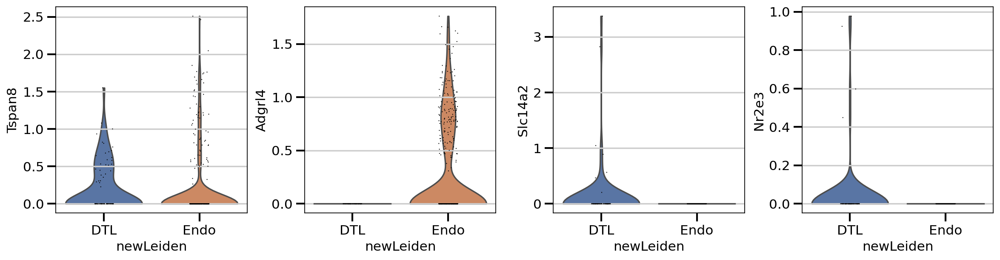

In [63]:
sc.pl.violin(endo, use_raw=False, keys = ['Tspan8', 'Adgrl4', 'Slc14a2', 'Nr2e3'], groupby='newLeiden',palette=MY_PALETTES['deep'], save='endo_violin_SCVI_full.svg')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


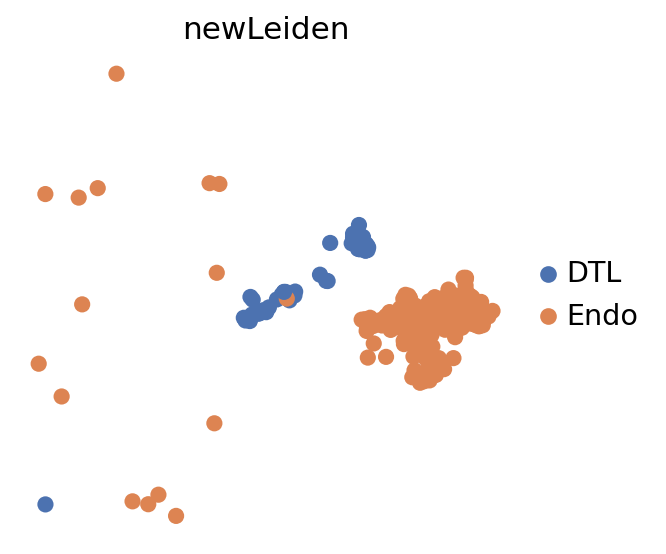

In [64]:
sc.pl.umap(endo, color='newLeiden', palette=MY_PALETTES['deep'],  save='endo-park_newleiden_SCVI_full.svg')

In [65]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
Park_int.obs['Celltype_Park'].cat.add_categories(['DTL'], inplace=True)
integrated_atlas.obs['Celltype_Park'].cat.add_categories(['DTL'], inplace=True)

new_ct = ['DTL', 'Unknown']
for ct in new_ct:
    Park_int.obs['Celltype_Park'].loc[endo[endo.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Park'].loc[endo[endo.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[endo[endo.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[endo[endo.obs['newLeiden'] == ct].obs.index] = ct


### PT 

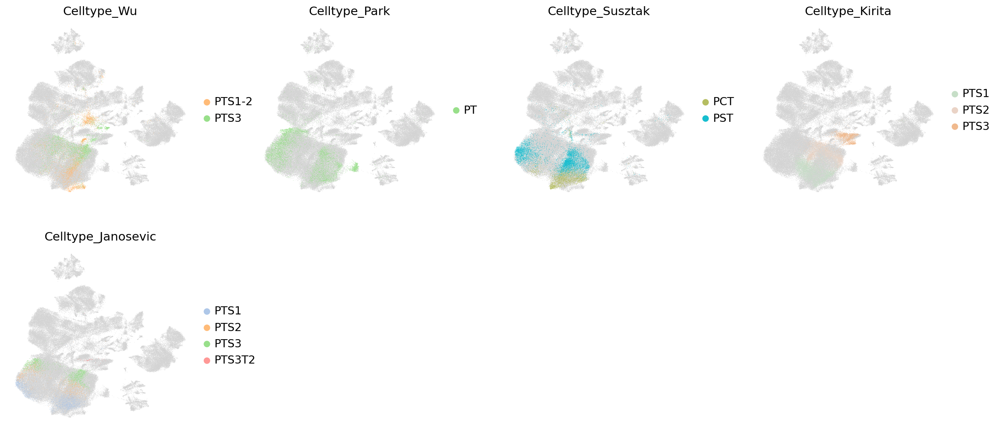

In [115]:
sc.pl.umap(atlas, groups=['PTS1-2', 'PT', 'PTS1', 'PTS2', 'PTS3', 'PCT', 'PST', 'PTS3T2'], color=[ 'Celltype_Wu', 'Celltype_Park', 'Celltype_Susztak', 'Celltype_Kirita', 'Celltype_Janosevic'], na_in_legend=False, save='PT_SCVI_Full.svg')

In [17]:
S3T2_Markers_eLIFE = ['Agt', 'Rnf24', 'Slc22a7', 'Bcat1', 'Serpina1d', 'Serpina1f', 'Mettl7a2', 'Cyp7b1']

In [18]:
S3_Markers_eLIFE = ['Cndp2', 'Cyp2e1', 'Slc7a13', 'Cyp4b1', 'Slc27a2', 'Napsa', 'Atp11a']

In [19]:
S2_Markers_eLIFE = ['Susd2', 'Slco1a1', 'Slc13a3', 'Slc27a2', 'Slc5a10', 'Slc22a2', 'Ass1', 'Miox', 'Guca2b', 'Cela1', 'Slc22a8', 'Dbi', 'Aldob', 'Cyb5a' ]

In [20]:
S1_Markers_eLIFE = ['Spp2', 'Apoe', 'Gatm', 'Slc5a2', 'Gpx3', 'Slc5a12']

In [21]:
PST_Markers = ["Atp11a", "Slc13a3", "Slc16a9", "Slc27a2", "Slc7a13", "Slc1a1"]

In [22]:
PCT_Markers = ["Slc5a2", "Slc5a12", "Adra1a", "Slc6a19", "Slc7a8", "Slc7a9"]

In [23]:
integrated_atlas.obs['Celltype_Kirita'].cat.add_categories(['PTS3T2'], inplace=True)
integrated_atlas.obs['Celltype_Susztak'].cat.add_categories([ 'PTS3T2', 'PTS1', 'PTS2', 'PTS3'], inplace=True)
integrated_atlas.obs['Celltype_Park'].cat.add_categories(['PTS3T2', 'PTS1', 'PTS2', 'PTS3'], inplace=True)
integrated_atlas.obs['Celltype_Wu'].cat.add_categories(['PTS3T2', 'PTS1', 'PTS2'], inplace=True)

In [24]:
integrated_atlas.obs['Celltype_Susztak'].cat.categories

Index(['DCT', 'Endo', 'IC', 'LOH', 'Macro', 'Neutro', 'PC', 'PCT', 'PST',
       'Podo', 'Stroma', 'Unknown', 'PTS3T2', 'PTS1', 'PTS2', 'PTS3'],
      dtype='object')

#### Together

##### Janosevic

In [124]:
janosevic_pts = Janosevic[Janosevic.obs['Celltype_Janosevic'].isin(['PTS1', 'PTS3T2', 'PTS2','PTS3'])].copy()

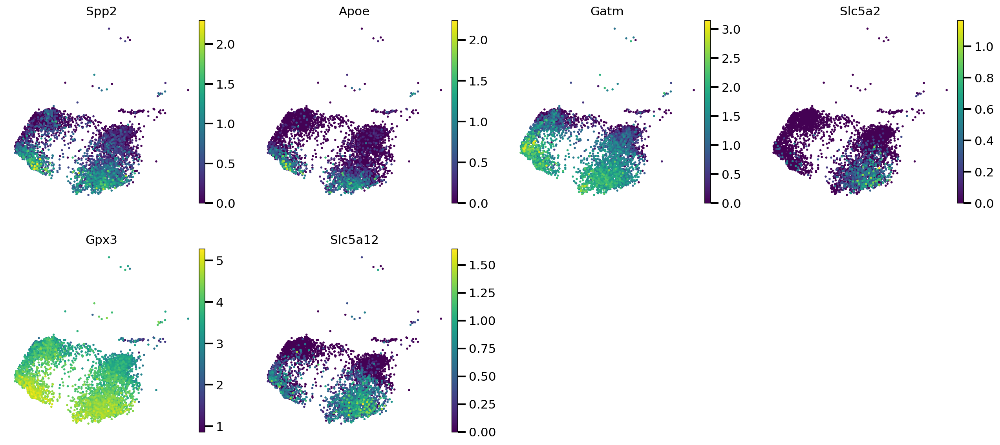

In [125]:
sc.pl.umap(janosevic_pts, color=S1_Markers_eLIFE, save='Janosevic_S1_SCVI_Full.svg')

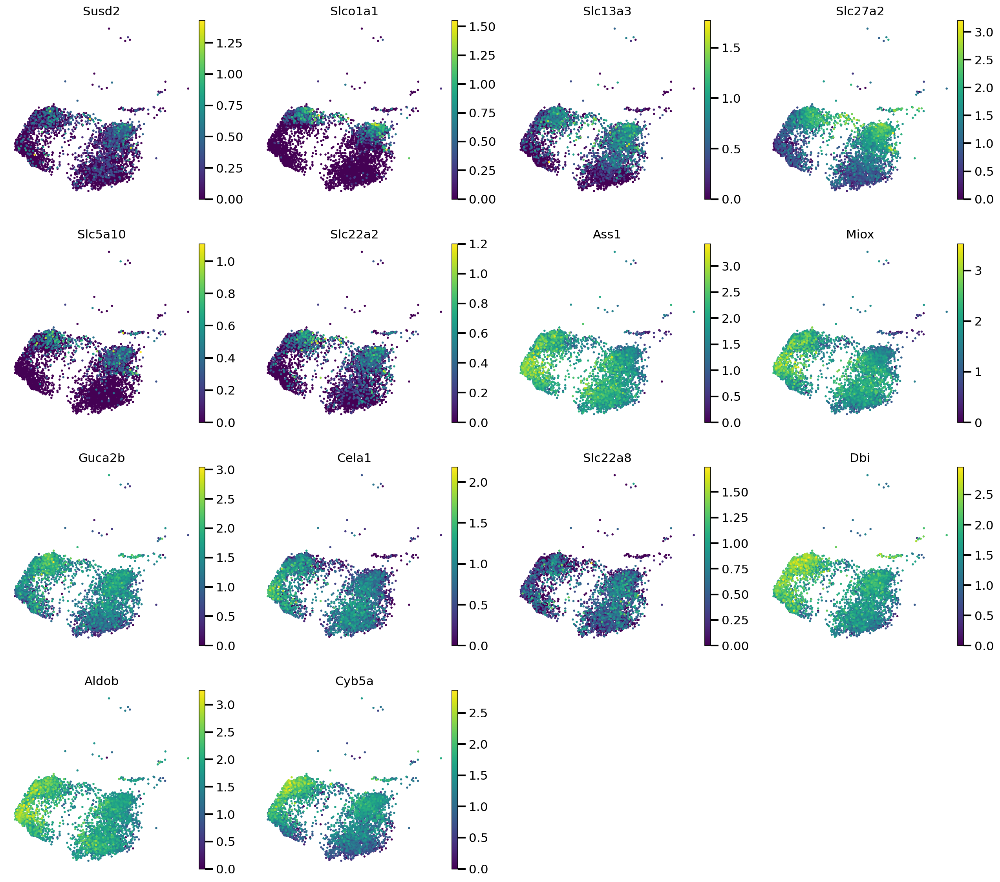

In [126]:
sc.pl.umap(janosevic_pts, color=S2_Markers_eLIFE, save='Janosevic_S2_SCVI_Full.svg')

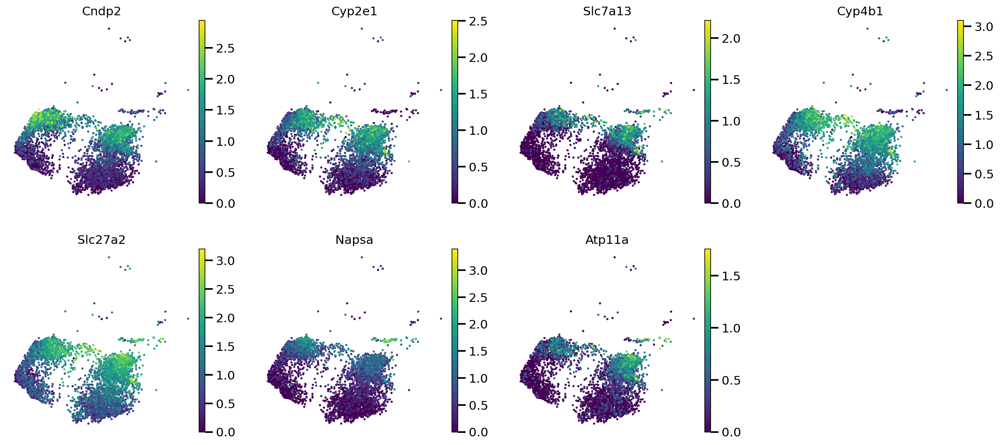

In [127]:
sc.pl.umap(janosevic_pts, color=S3_Markers_eLIFE, save='Janosevic_S3_SCVI_Full.svg')

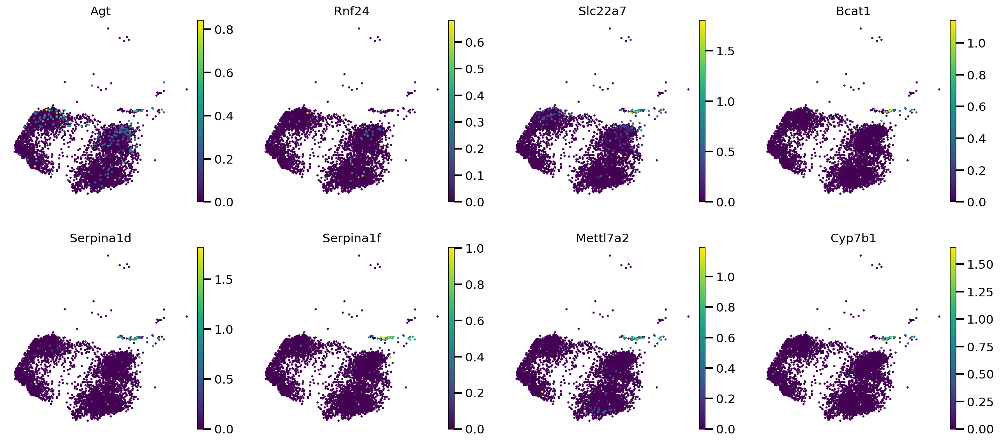

In [128]:
sc.pl.umap(janosevic_pts, color=S3T2_Markers_eLIFE, save='Janosevic_S3T2_SCVI_Full.svg')

##### Kirita

In [90]:
kirita_pts = Kirita[Kirita.obs['Celltype_Kirita'].isin(['PTS1','PTS2','PTS3'])].copy()

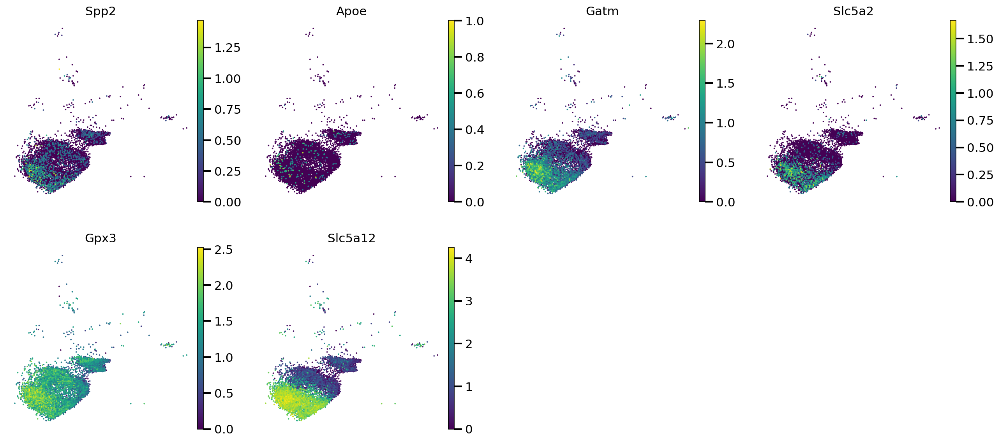

In [91]:
sc.pl.umap(kirita_pts, color=S1_Markers_eLIFE, save='Kirita_S1_SCVI_Full.svg')

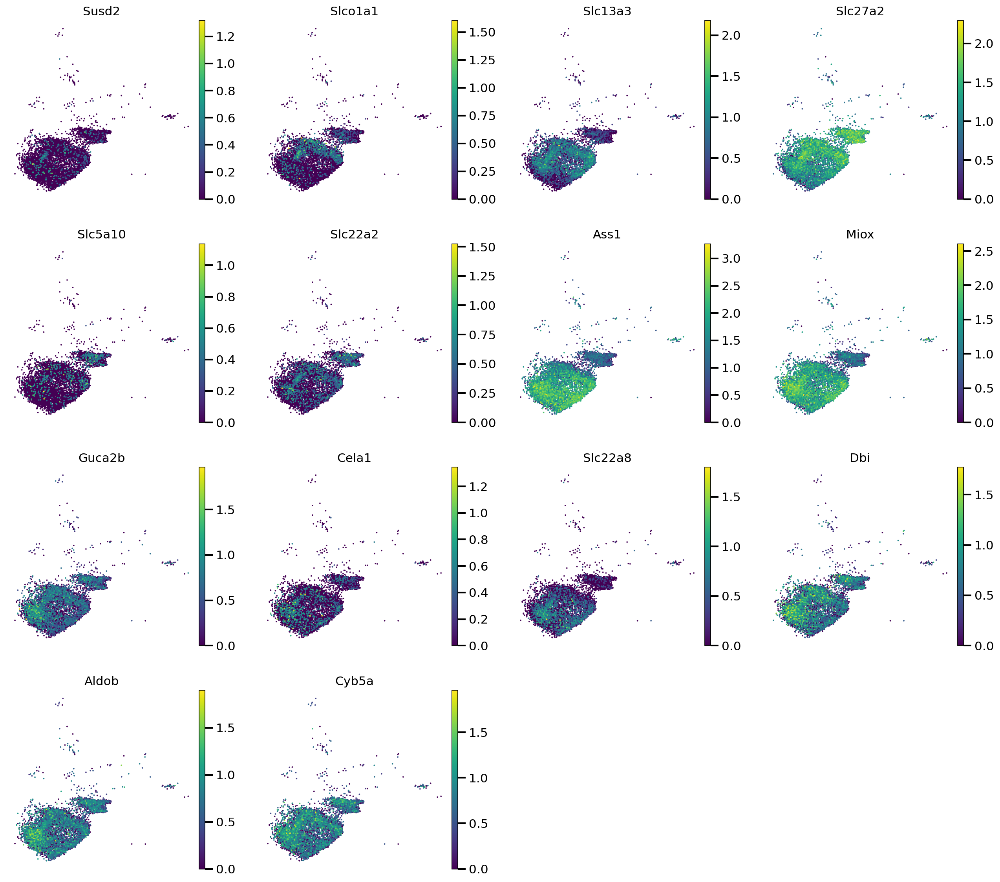

In [92]:
sc.pl.umap(kirita_pts, color=S2_Markers_eLIFE, save='Kirita_S2_SCVI_Full.svg')

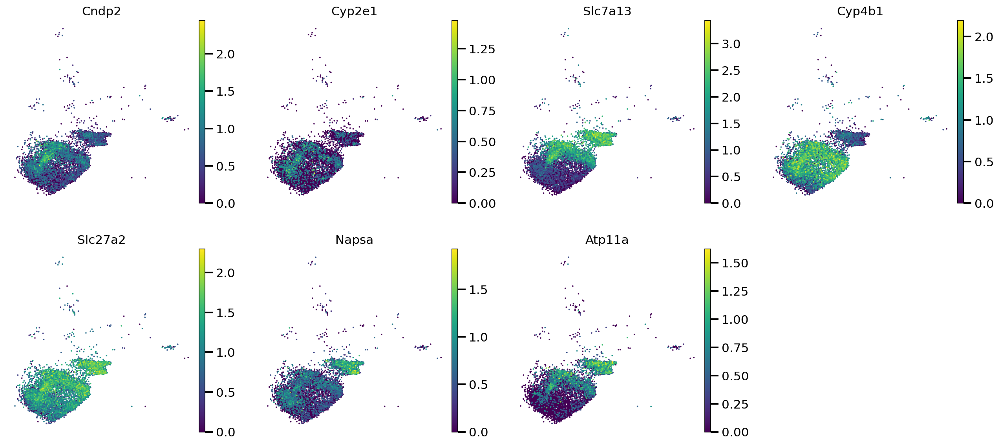

In [93]:
sc.pl.umap(kirita_pts, color=S3_Markers_eLIFE, save='Kirita_S3_SCVI_Full.svg')

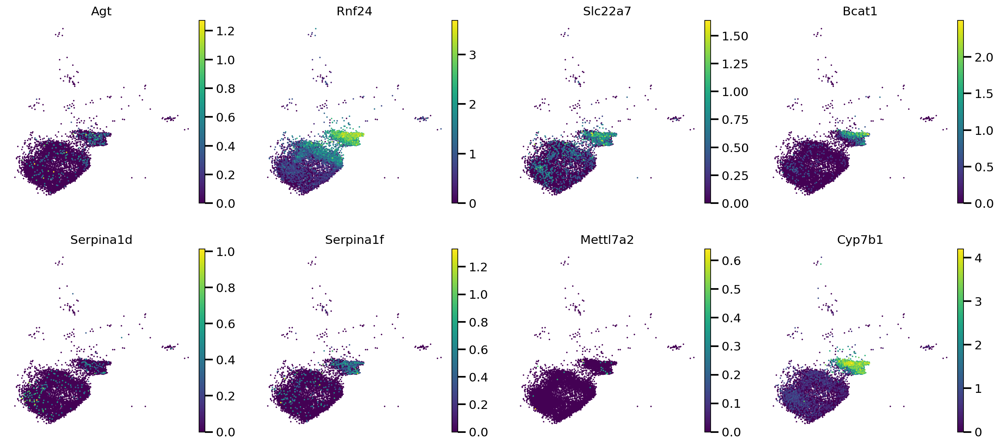

In [94]:
sc.pl.umap(kirita_pts, color=S3T2_Markers_eLIFE, save='Kirita_S3T2_SCVI_Full.svg')

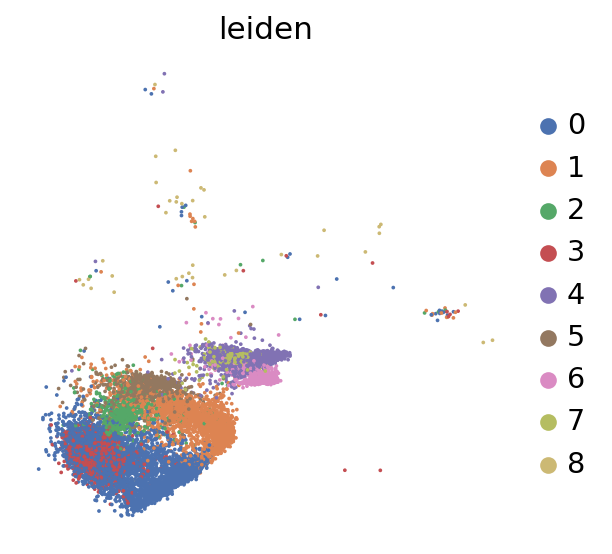

In [95]:
sc.pp.neighbors(kirita_pts)
sc.tl.leiden(kirita_pts, resolution=0.5)
# sc.tl.leiden(kirita_pts, restrict_to=('leiden', ['1']), resolution=0.3)
sc.pl.umap(kirita_pts, color='leiden', palette=MY_PALETTES['deep'], save='Kirita_Leiden_SCVI_Full.svg')

In [96]:
leiden_rename = {
    '0': 'PTS1',
    '1': 'PTS2',
    '2': 'PTS2',
    '3': 'Unknown',
    '4': 'PTS3T2',
    '5': 'PTS3',
    '6': 'PTS3T2',
    '7': 'Unknown',
    '8': 'Unknown'}

kirita_pts.obs['newLeiden'] = kirita_pts.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [29]:
palette = {
    'PTS1':'#4C72B0',
    'PTS2': '#DD8452',
    'PTS3': '#55A868',
    'PTS3T2': '#C44E52',
    'Unknown': 'grey'
}

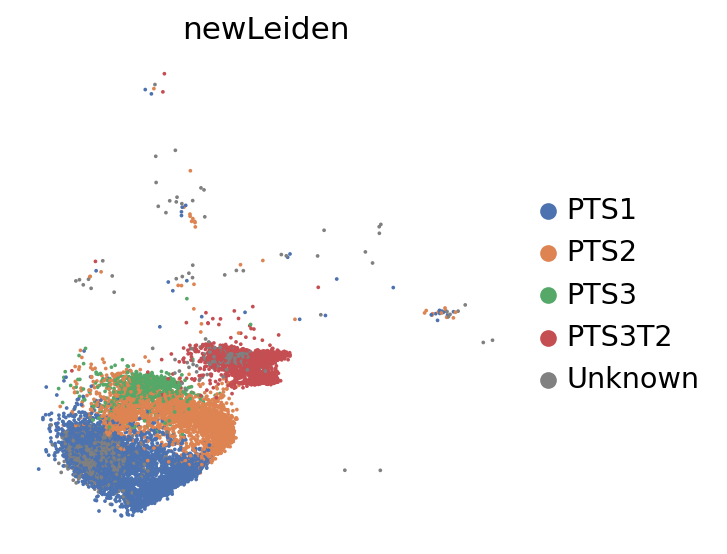

In [98]:
sc.pl.umap(kirita_pts, color='newLeiden', palette=palette, save='Kirita_Leiden_SCVI_Full_Resolved.svg')

In [100]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
atlas.obs['Celltype_finest'].loc[kirita_pts[kirita_pts.obs['newLeiden'] == 'Unknown'].obs.index] = 'Unknown'

# integrated_atlas.obs['Celltype_Kirita'].cat.add_categories(['Unknown', 'PTS3T2'], inplace=True)
Kirita_int.obs['Celltype_Kirita'].cat.add_categories(['PTS3T2', 'Unknown'], inplace=True)



new_ct = ['PTS2', 'PTS3', 'PTS3T2', 'Unknown']
for ct in new_ct:
    Kirita_int.obs['Celltype_Kirita'].loc[kirita_pts[kirita_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Kirita'].loc[kirita_pts[kirita_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[kirita_pts[kirita_pts.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[kirita_pts[kirita_pts.obs['newLeiden'] == ct].obs.index] = ct

##### Miao

In [101]:
miao_pts = Miao[Miao.obs['Celltype_Susztak'].isin(['PCT', 'PST'])].copy()

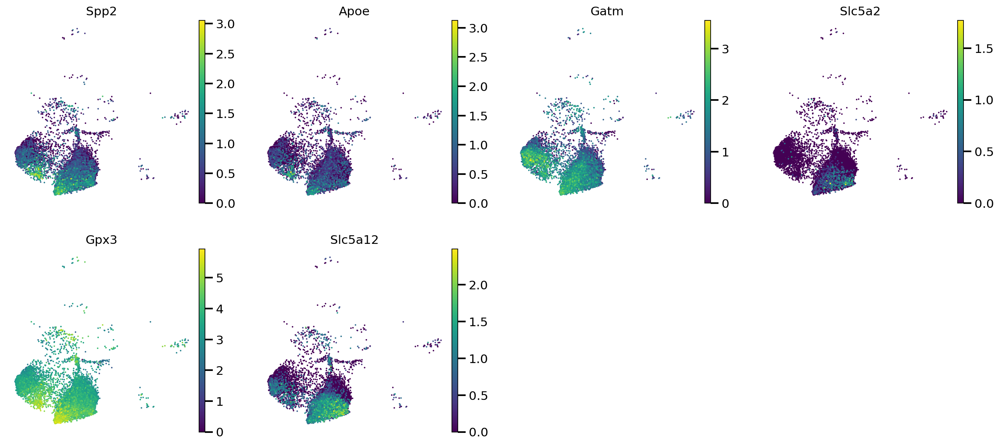

In [141]:
sc.pl.umap(miao_pts, color=S1_Markers_eLIFE, save='Miao_S1_SCVI_Full.svg')

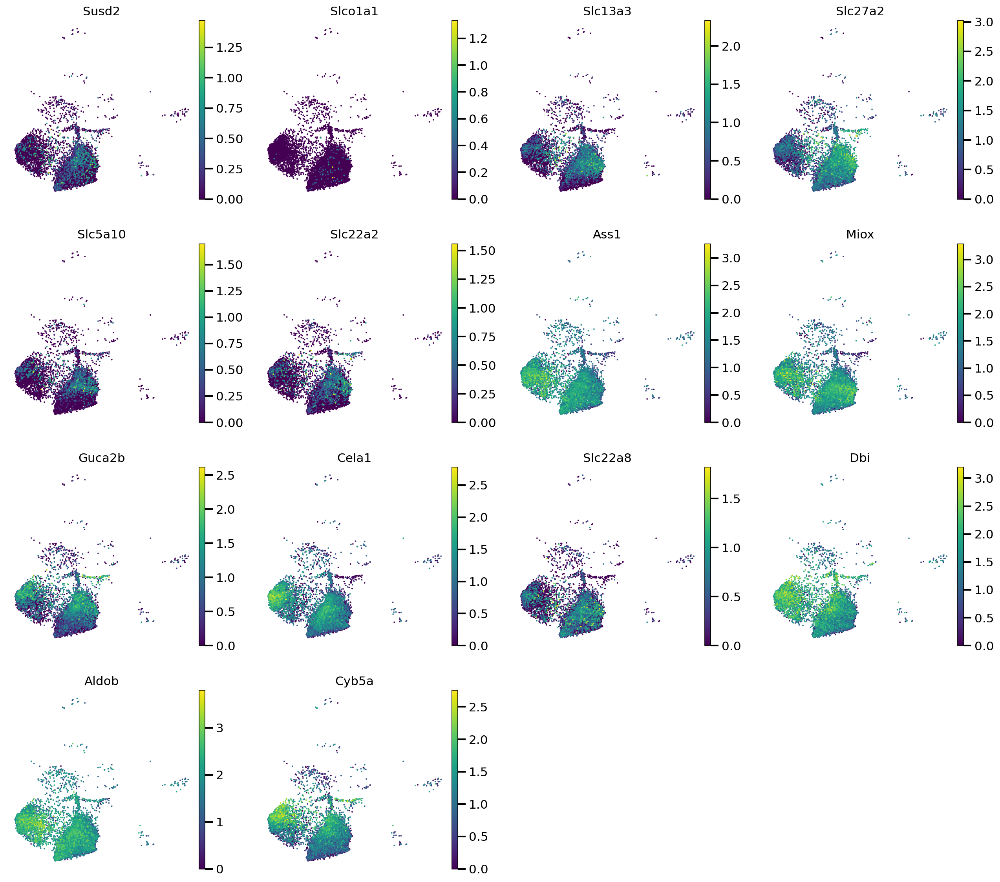

In [142]:
sc.pl.umap(miao_pts, color=S2_Markers_eLIFE, save='Miao_S2_SCVI_Full.svg')

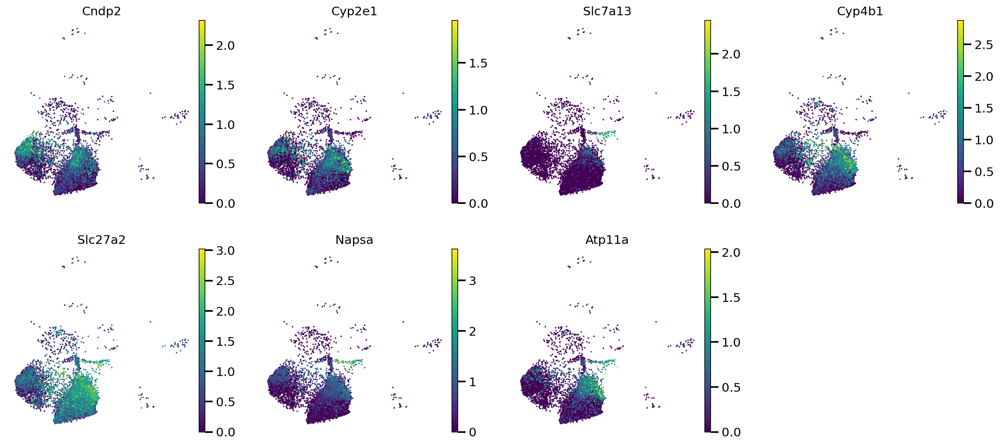

In [143]:
sc.pl.umap(miao_pts, color=S3_Markers_eLIFE, save='Miao_S3_SCVI_Full.svg')

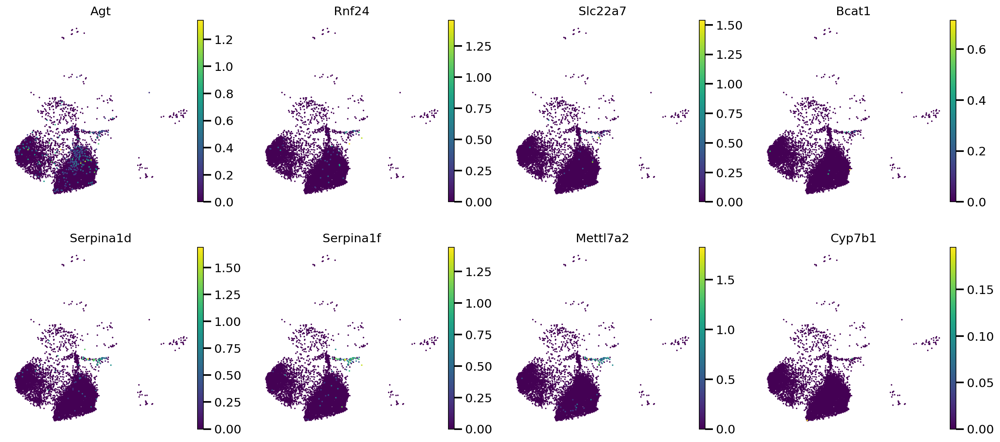

In [144]:
sc.pl.umap(miao_pts, color=S3T2_Markers_eLIFE, save='Miao_S3T2_SCVI_Full.svg')

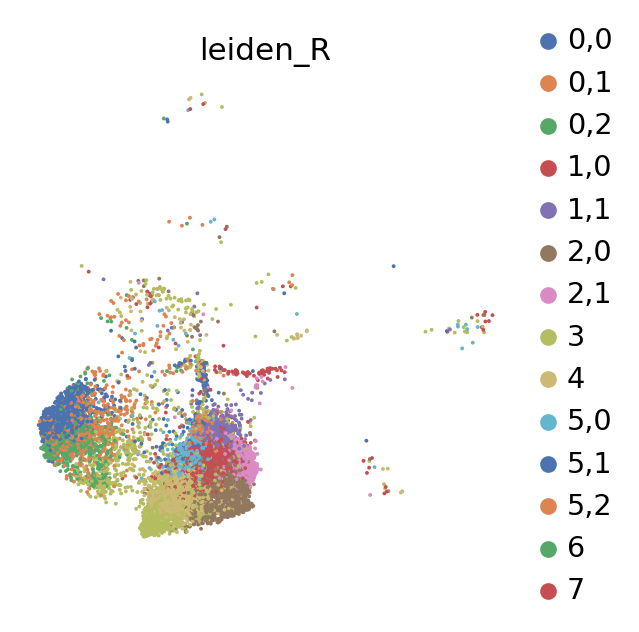

In [102]:
sc.pp.neighbors(miao_pts)
sc.tl.leiden(miao_pts, resolution=0.5)
sc.tl.leiden(miao_pts, restrict_to=('leiden', ['2']), resolution=0.2)
sc.tl.leiden(miao_pts, restrict_to=('leiden_R', ['0']), resolution=0.3)
sc.tl.leiden(miao_pts, restrict_to=('leiden_R', ['1']), resolution=0.2)
sc.tl.leiden(miao_pts, restrict_to=('leiden_R', ['5']), resolution=0.3)

sc.pl.umap(miao_pts, color='leiden_R',palette=MY_PALETTES['deep'], save='Miao_Leiden_SCVI_Full.svg')


In [103]:
leiden_rename = {
    '0,0': 'PTS2',
    '0,1': 'PTS2',
    '0,2': 'PTS2',
    '1,0': 'PTS2',
    '1,1': 'PTS3',
    '2,0': 'PTS1',
    '2,1': 'PTS3',
    '3': 'PTS1',
    '4': 'PTS2',
    '5,0': 'PTS2',
    '5,1': 'PTS3',
    '5,2': 'PTS3',
    '6': 'Unknown',
    '7': 'PTS3T2'}

miao_pts.obs['newLeiden'] = miao_pts.obs['leiden_R'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


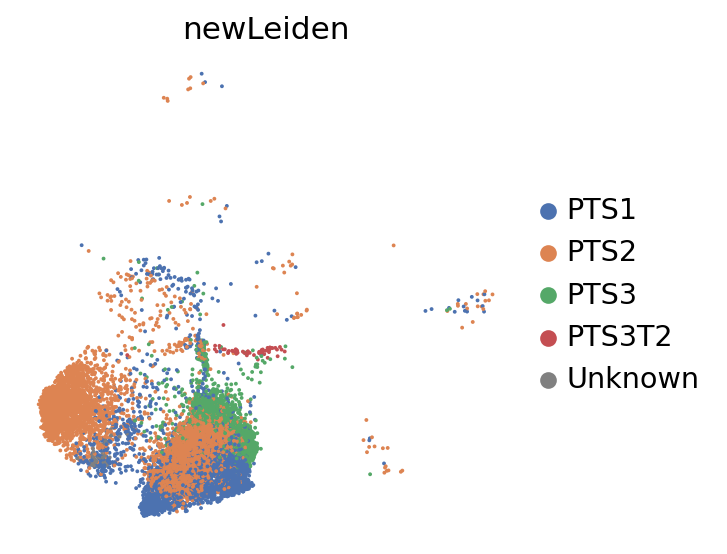

In [104]:
sc.pl.umap(miao_pts, color='newLeiden', palette=palette, save='Miao_Leiden_SCVI_Full_Resolved.svg')

In [105]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
Miao_int.obs['Celltype_Susztak'].cat.add_categories(['PTS1', 'PTS2', 'PTS3', 'PTS3T2'], inplace=True)


new_ct = ['PTS1', 'PTS2', 'PTS3', 'PTS3T2', 'Unknown']
for ct in new_ct:
    Miao_int.obs['Celltype_Susztak'].loc[miao_pts[miao_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Susztak'].loc[miao_pts[miao_pts.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[miao_pts[miao_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[miao_pts[miao_pts.obs['newLeiden'] == ct].obs.index] = ct


##### Park

In [106]:
park_pts = Park[Park.obs['Celltype_Park'].isin(['PT'])].copy()

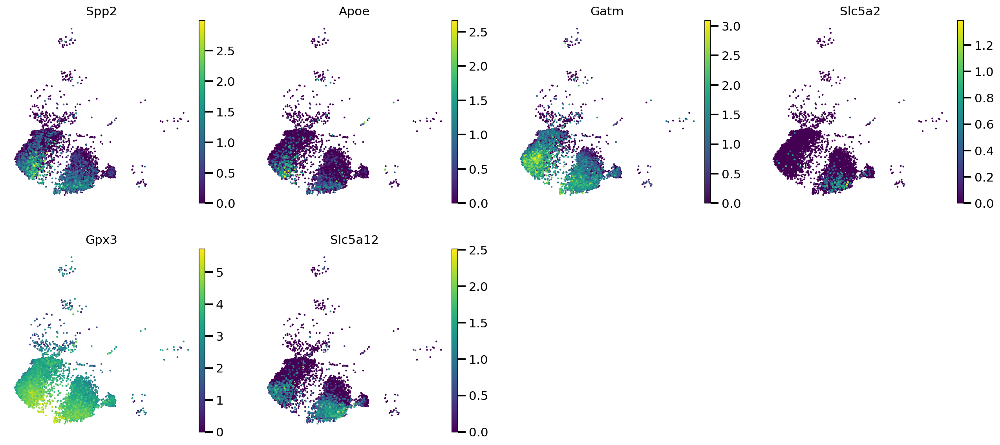

In [196]:
sc.pl.umap(park_pts, color = S1_Markers_eLIFE, save='Park_S1_SCVI_Full.svg')

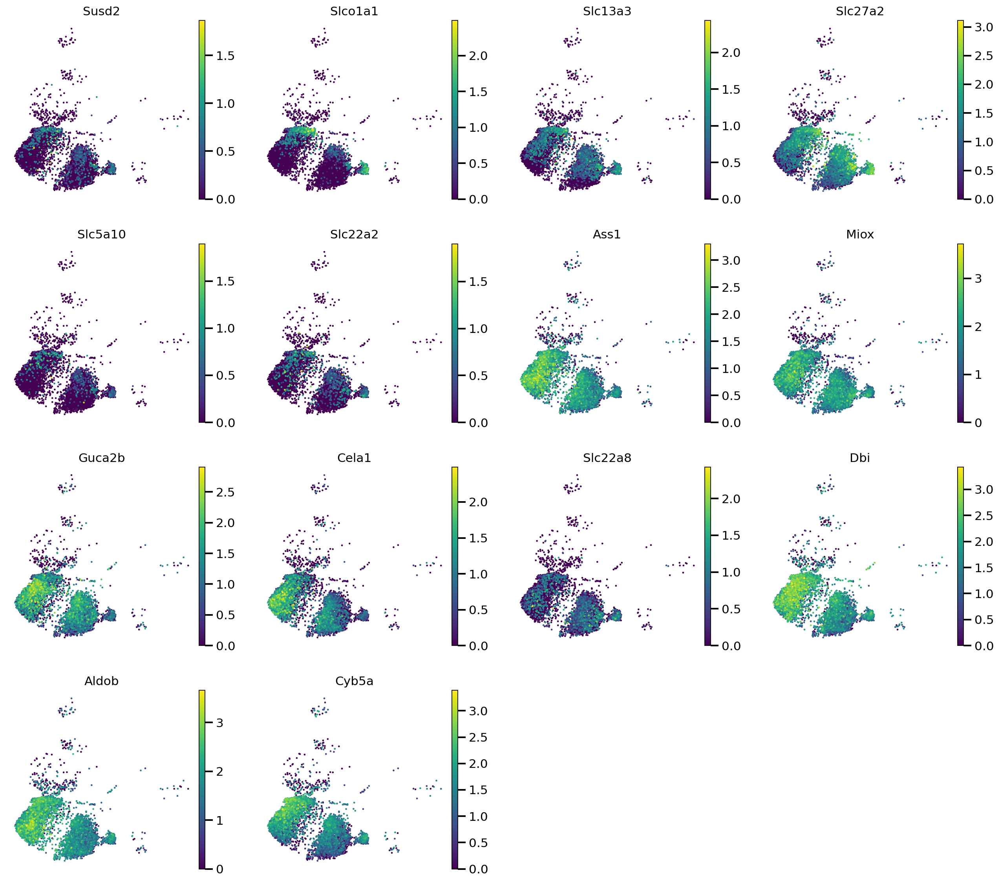

In [197]:
sc.pl.umap(park_pts, color = S2_Markers_eLIFE, save='Park_S2_SCVI_Full.svg')

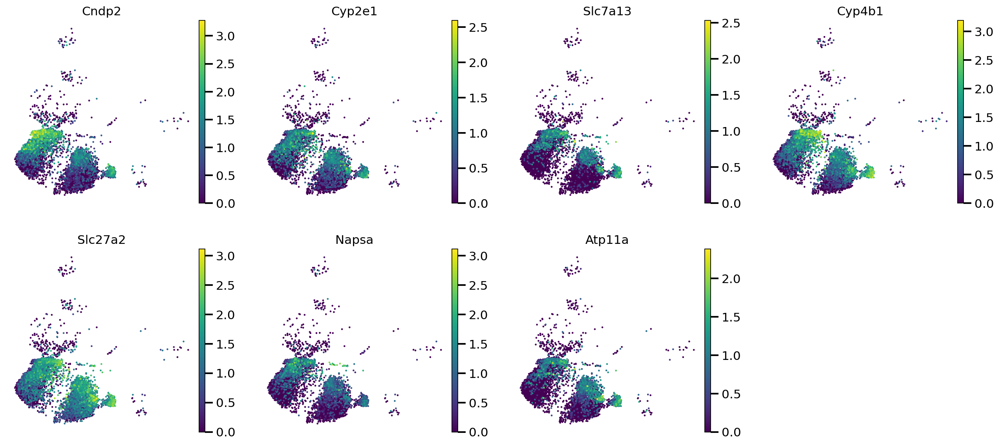

In [198]:
sc.pl.umap(park_pts, color = S3_Markers_eLIFE, save='Park_S3_SCVI_Full.svg')

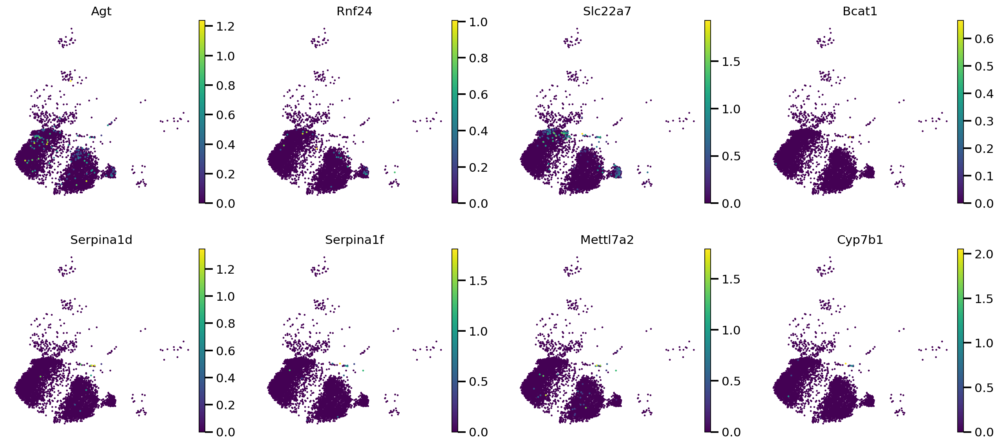

In [199]:
sc.pl.umap(park_pts, color = S3T2_Markers_eLIFE, save='Park_S3T2_SCVI_Full.svg')

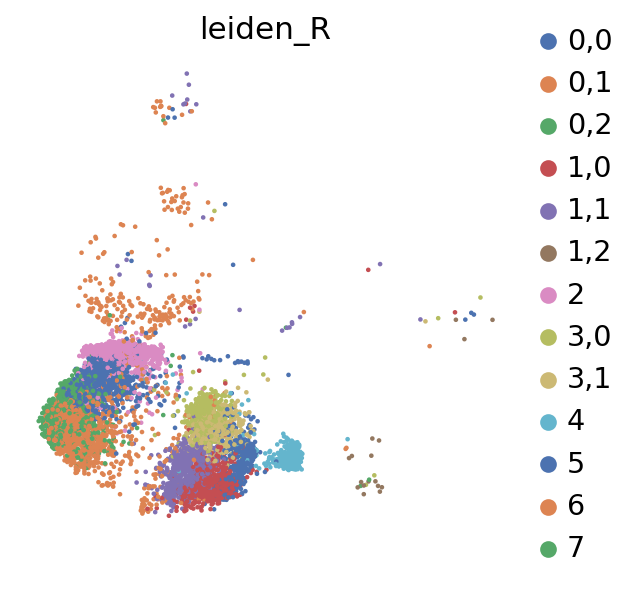

In [107]:
sc.pp.neighbors(park_pts)
sc.tl.leiden(park_pts, resolution=0.3)
sc.tl.leiden(park_pts, restrict_to=('leiden', ['0']), resolution=0.2)
sc.tl.leiden(park_pts, restrict_to=('leiden_R', ['1']), resolution=0.2)
sc.tl.leiden(park_pts, restrict_to=('leiden_R', ['3']), resolution=0.2)
sc.pl.umap(park_pts, color='leiden_R', save='Park_Leiden_SCVI_Full.svg', palette=MY_PALETTES['deep'])

In [108]:
leiden_rename = {
    '0,0': 'PTS2',
    '0,1': 'PTS1',
    '0,2': 'PTS1',
    '1,0': 'PTS1',
    '1,1': 'PTS1',
    '1,2': 'Unknown',
    '2': 'PTS3',
    '3,0': 'PTS2',
    '3,1': 'PTS2',
    '4': 'Unknown',
    '5': 'PTS3',
    '6': 'Unknown',
    '7': 'PTS1'}

park_pts.obs['newLeiden'] = park_pts.obs['leiden_R'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


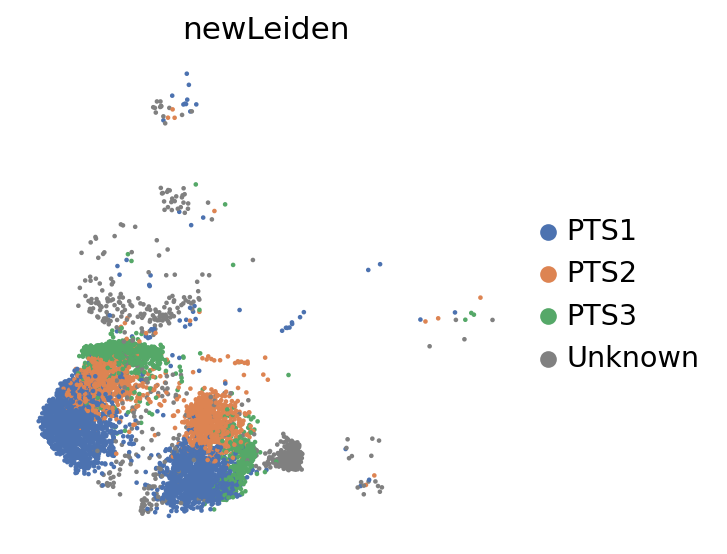

In [109]:
sc.pl.umap(park_pts, color='newLeiden', palette=palette, save='Park_Leiden_SCVI_Full_Resolved.svg')

In [110]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
Park_int.obs['Celltype_Park'].cat.add_categories(['PTS1', 'PTS2', 'PTS3', 'PTS3T2'], inplace=True)


new_ct = ['PTS1', 'PTS2', 'PTS3', 'PTS3T2', 'Unknown']
for ct in new_ct:
    Park_int.obs['Celltype_Park'].loc[park_pts[park_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Park'].loc[park_pts[park_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[park_pts[park_pts.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[park_pts[park_pts.obs['newLeiden'] == ct].obs.index] = ct

##### Wu

In [25]:
wu_pts = Wu[Wu.obs['Celltype_Wu'].isin(['PTS1-2'])].copy()

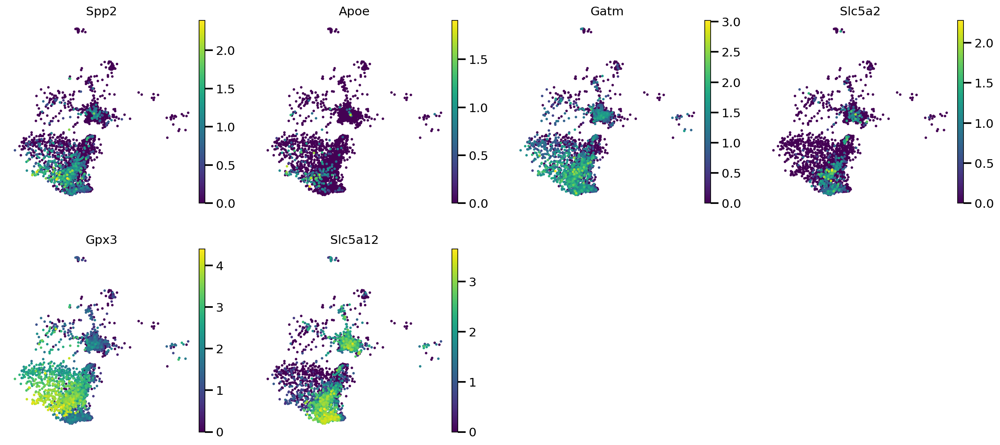

In [212]:
sc.pl.umap(wu_pts, color = S1_Markers_eLIFE, save='Wu_S1_SCVI_Full.svg')

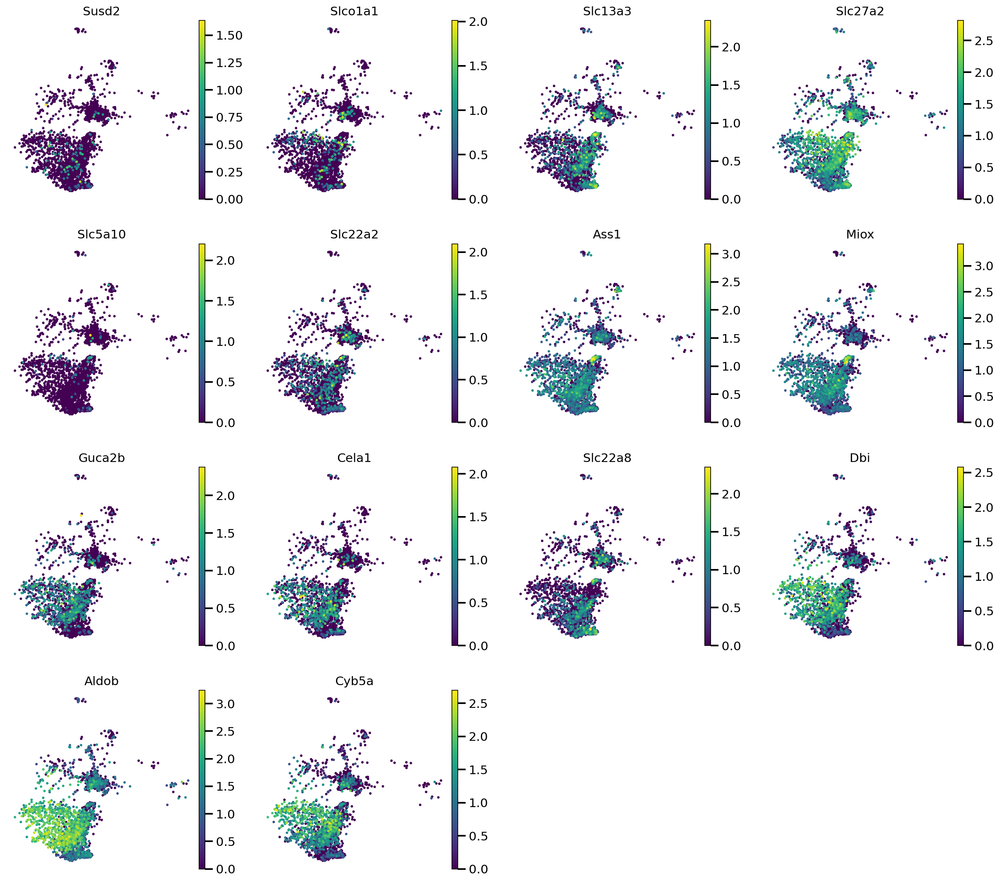

In [213]:
sc.pl.umap(wu_pts, color = S2_Markers_eLIFE, save='Wu_S2_SCVI_Full.svg')

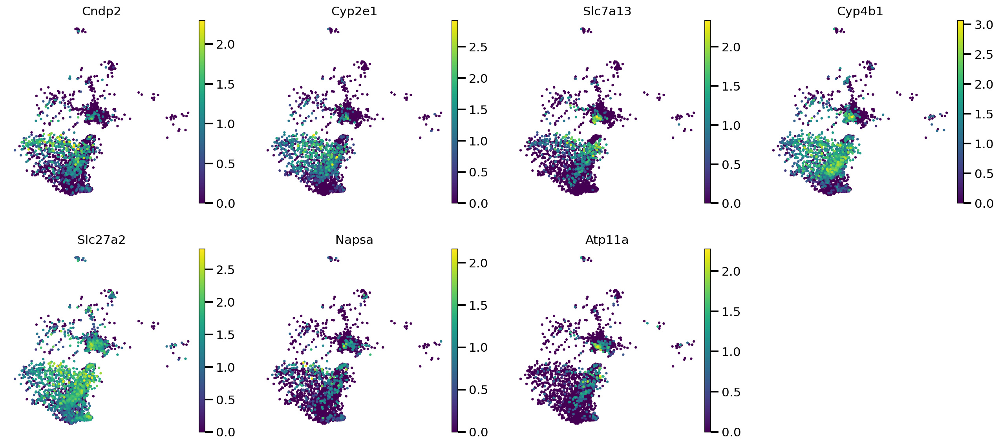

In [214]:
sc.pl.umap(wu_pts, color = S3_Markers_eLIFE, save='Wu_S3_SCVI_Full.svg')

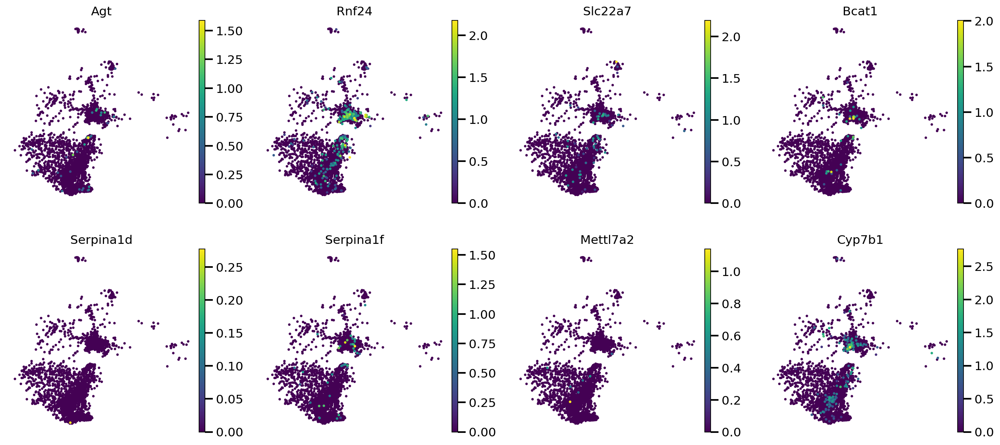

In [215]:
sc.pl.umap(wu_pts, color = S3T2_Markers_eLIFE, save='Wu_S3T2_SCVI_Full.svg')

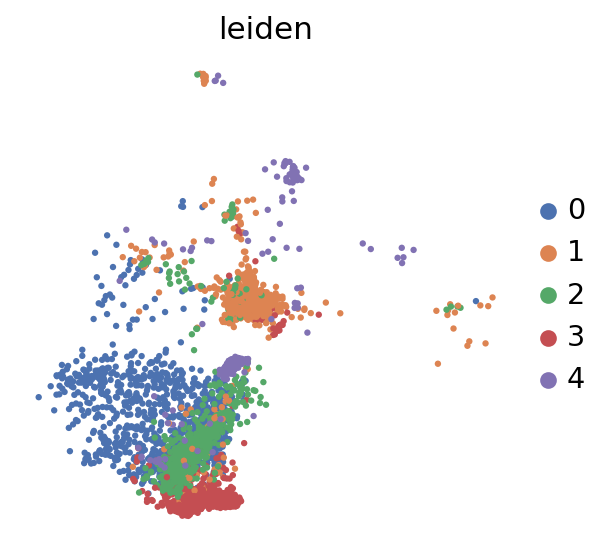

In [26]:
sc.pp.neighbors(wu_pts)
sc.tl.leiden(wu_pts, resolution=0.3)
# sc.tl.leiden(wu_pts, restrict_to=('leiden', ['1']), resolution=0.2)
# sc.tl.leiden(wu_pts, restrict_to=('leiden_R', ['0']), resolution=0.2)
sc.pl.umap(wu_pts, color='leiden', palette=MY_PALETTES['deep'])

In [27]:
leiden_rename = {
    '0': 'PTS2',
    '1': 'Unknown',
    '2': 'PTS1',
    '3': 'PTS1',
    '4': 'Unknown'}

wu_pts.obs['newLeiden'] = wu_pts.obs['leiden'].replace(leiden_rename).astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


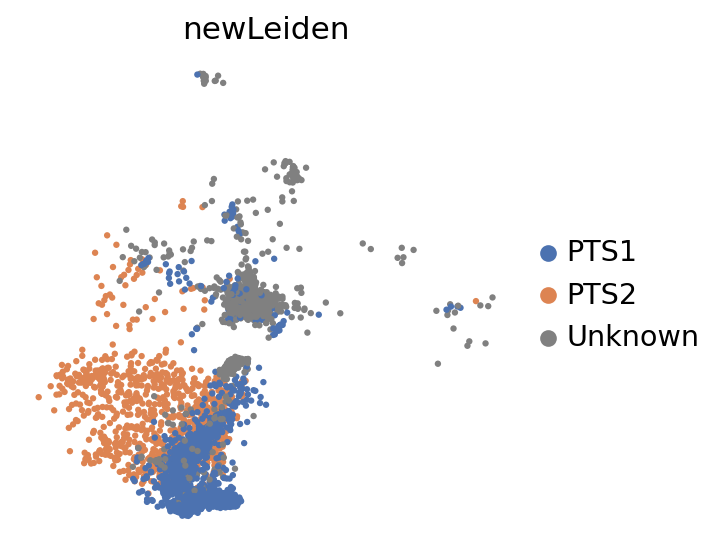

In [30]:
sc.pl.umap(wu_pts, color='newLeiden', palette=palette, save='Wu_Leiden_SCVI_Full_Resolved.svg')

In [142]:
# rename barcodes as pt both for the subset and for the whole atlas, also add the contaminant cells as unknown and let the classifier annotate them
Wu_int.obs['Celltype_Wu'].cat.add_categories(['PTS1', 'PTS2', 'Unknown'], inplace=True)

new_ct = ['PTS1', 'PTS2', 'Unknown']
for ct in new_ct:
    Wu_int.obs['Celltype_Wu'].loc[wu_pts[wu_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_Wu'].loc[wu_pts[wu_pts.obs['newLeiden'] == ct].obs.index] = ct
    integrated_atlas.obs['Celltype_finest'].loc[wu_pts[wu_pts.obs['newLeiden'] == ct].obs.index] = ct
    atlas.obs['Celltype_finest'].loc[wu_pts[wu_pts.obs['newLeiden'] == ct].obs.index] = ct

Set all categories to categorical dtype

In [115]:
Miao_int.obs['Celltype_Susztak'] = Miao_int.obs['Celltype_Susztak'].astype('category')
Kirita_int.obs['Celltype_Kirita'] = Kirita_int.obs['Celltype_Kirita'].astype('category')
Park_int.obs['Celltype_Park'] = Park_int.obs['Celltype_Park'].astype('category')
Wu_int.obs['Celltype_Wu'] = Wu_int.obs['Celltype_Wu'].astype('category')
Janosevic_int.obs['Celltype_Janosevic'] = Janosevic_int.obs['Celltype_Janosevic'].astype('category')

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  
/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  after removing the cwd from sys.path.


### Adding perfect matches to training data

According to the tree:
- Janosevic lymphocytes are indeed T lypmhocytes
- Janosevic Mp/DC cells do not match with the other Macrophage populations

I therefore rename these cells in the training data accordingly

In [144]:
 integrated_atlas.obs['Celltype_finest'].cat.add_categories(['DC'], inplace=True)

integrated_atlas.obs['Celltype_finest'].loc[integrated_atlas[integrated_atlas.obs['Celltype_finest'] == 'Lymphocytes'].obs.index] = 'T lymph'
integrated_atlas.obs['Celltype_finest'].loc[integrated_atlas[integrated_atlas.obs['Celltype_finest'] == 'Mp/DC'].obs.index] = 'DC'
integrated_atlas.obs['Celltype_finest'].loc[integrated_atlas[integrated_atlas.obs['Celltype_finest'] == 'Peri_Stromal'].obs.index] = 'Per'

In [140]:
atlas.obs['Celltype_finest'].cat.add_categories(['DC'], inplace=True)

atlas.obs['Celltype_finest'].loc[atlas[atlas.obs['Celltype_finest'] == 'Lymphocytes'].obs.index] = 'T lymph'
atlas.obs['Celltype_finest'].loc[atlas[atlas.obs['Celltype_finest'] == 'Mp/DC'].obs.index] = 'DC'
atlas.obs['Celltype_finest'].loc[atlas[atlas.obs['Celltype_finest'] == 'Peri_Stromal'].obs.index] = 'Per'

## Re-train 

In [145]:
ref_scHPL = integrated_atlas[(integrated_atlas.obs['Origin'].isin(['Kirita20', 'Park18', 'Wu19', 'Miao21', 'Dumas20', 'Janosevic21'])) & (integrated_atlas.obs.Celltype_finest != 'Unknown')]

In [146]:
query_scHPL = integrated_atlas[(integrated_atlas.obs.Celltype_finest == 'Unknown') | (integrated_atlas.obs.Origin.isin(['Hinze20', 'Conway20']))].copy()

In [147]:
query_scHPL

AnnData object with n_obs × n_vars = 62451 × 3000
    obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [148]:
ref_scHPL

View of AnnData object with n_obs × n_vars = 78950 × 3000
    obs: 'Celltype_Kirita', 'Origin', 'Source', 'Technology', 'Tissue_res', 'Age', 'Genetic_background', 'Gender', 'n_genes', 'Celltype_Park', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'batch', 'Celltype_Susztak', 'Celltype_Wu', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'Celltype_finest', 'Celltype_Dumas', 'Celltype_Janosevic', '_scvi_batch', '_scvi_labels', 'leiden', 'Celltype_finest_lowres'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'neighbors', 'umap'
    obsm: 'X_scANVI', 'X_scVI', 'X_umap', '_scvi_extra_categorical_covs', '_scvi_extra_continuous_covs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [149]:
assert ref_scHPL.shape[0] + query_scHPL.shape[0] == integrated_atlas.shape[0] # make sure we split the data correctly and we are not missing any cells

In [150]:
ref_scHPL.obs['Celltype_finest_scHPL'] = ref_scHPL.obs[['Celltype_finest', 'Origin']].apply(lambda x: x.str.cat(sep='-'), axis=1)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel_launcher.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  """Entry point for launching an IPython kernel.


In [151]:
# store latent repr in own anndata object

ref_scHPL_X_scANVI = sc.AnnData(ref_scHPL.obsm['X_scANVI'])
ref_scHPL_X_scANVI.obs['Origin'] = ref_scHPL.obs['Origin'].to_list()
ref_scHPL_X_scANVI.obs['Celltype_finest_scHPL'] = ref_scHPL.obs['Celltype_finest_scHPL'].to_list()

Starting tree:


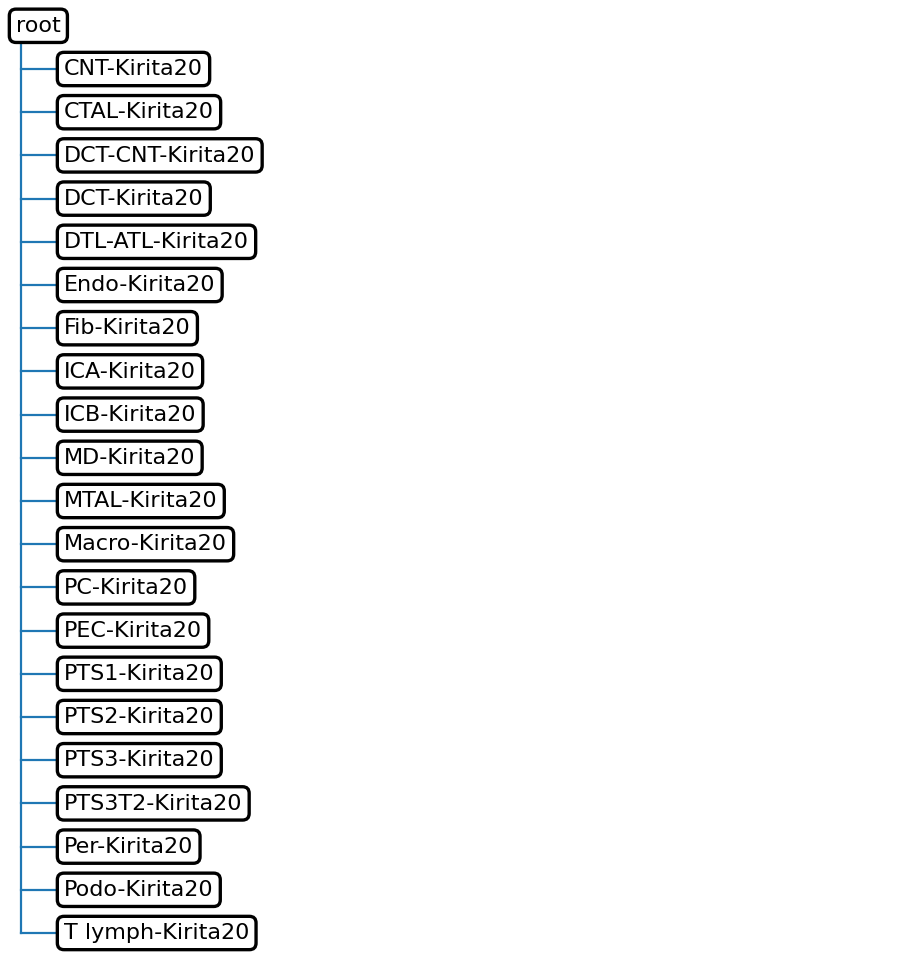


Adding dataset Wu19 to the tree

Updated tree:


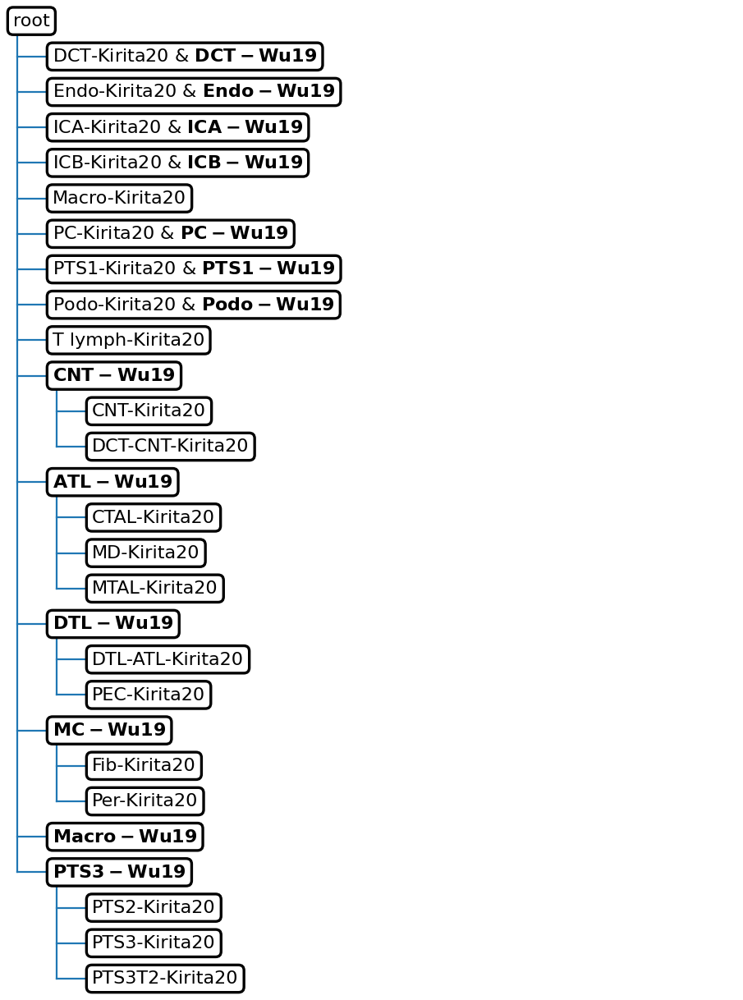


Adding dataset Miao21 to the tree

Updated tree:


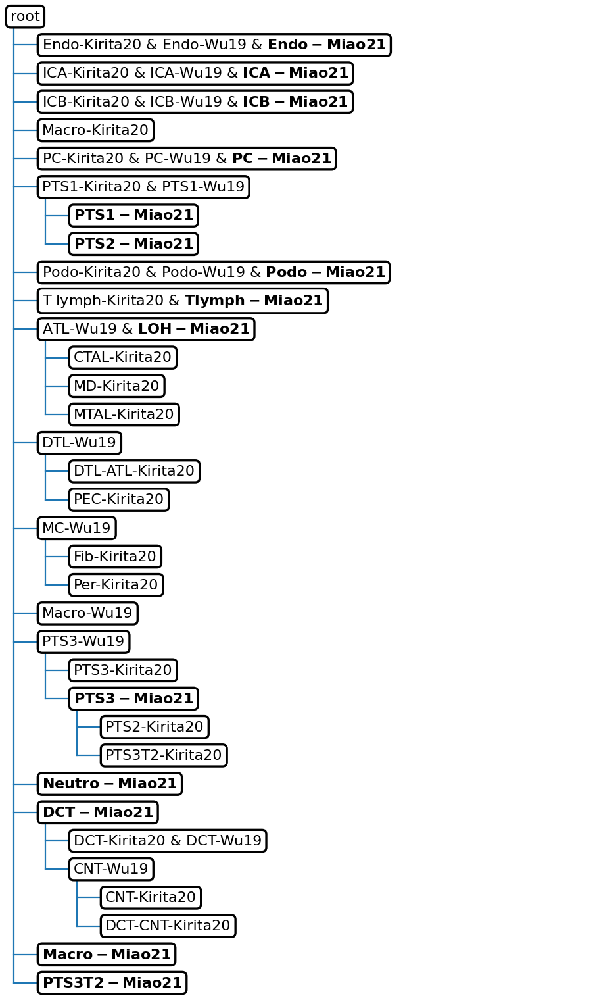


Adding dataset Janosevic21 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


These populations are missing from the tree: 
['PTS1-Janosevic21' 'PTS2-Janosevic21']

Updated tree:


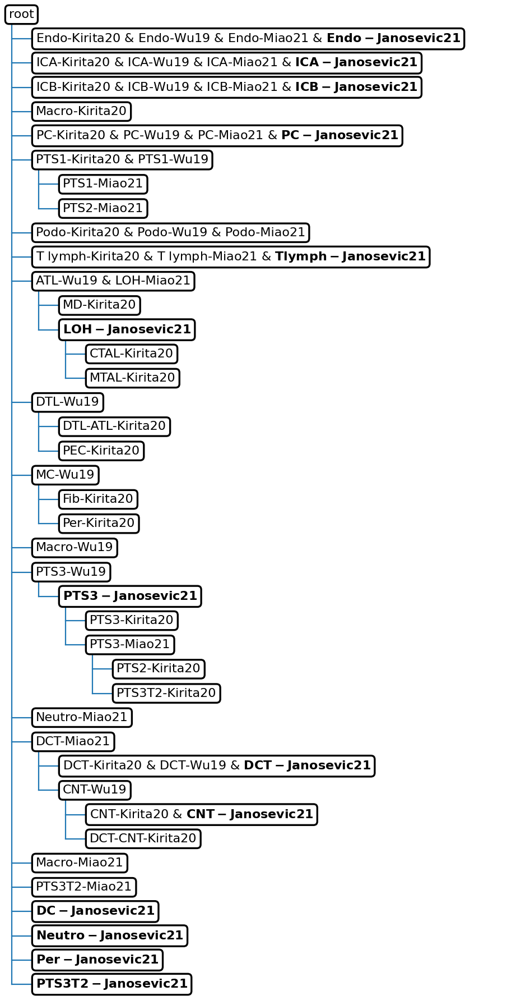


Adding dataset Park18 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


These populations are missing from the tree: 
['PTS3-Park18']

Updated tree:


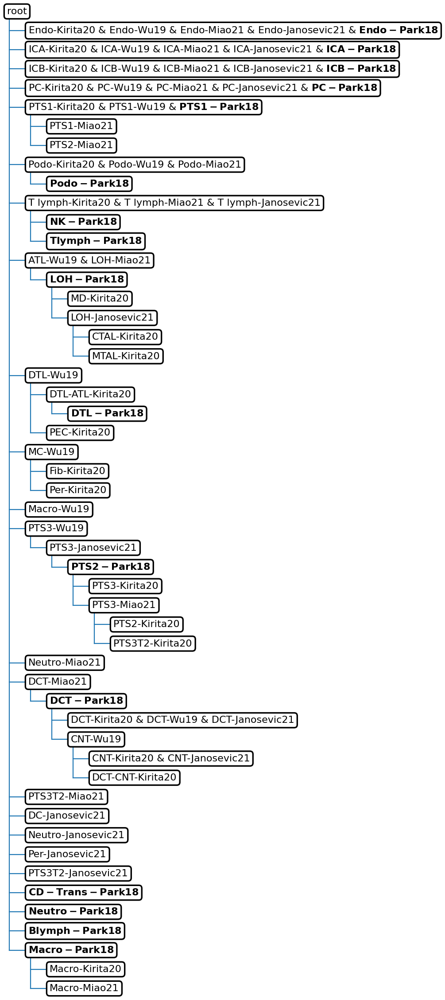


Adding dataset Dumas20 to the tree


/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)



Updated tree:


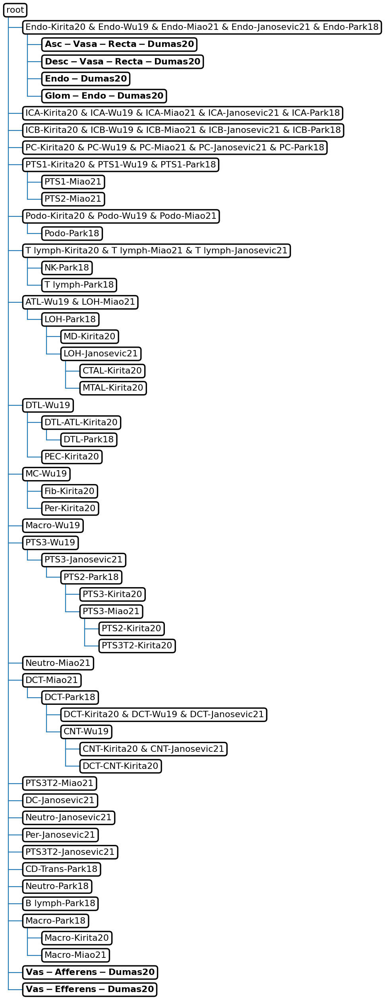

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/sklearn/model_selection/_split.py:672: UserWarning: The least populated class in y has only 3 members, which is less than n_splits=5.
  % (min_groups, self.n_splits)), UserWarning)


In [152]:
tree_ref, mp_ref = learn.learn_tree(data = ref_scHPL_X_scANVI , 
                batch_key = 'Origin',
                batch_order = ['Kirita20', 'Wu19', 'Miao21', 'Janosevic21', 'Park18', 'Dumas20'],
                cell_type_key='Celltype_finest_scHPL',
                classifier = 'knn')

In [227]:
ref_scHPL.write_h5ad("/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_int_curated_SCVI.h5ad")
query_scHPL.write_h5ad("/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_int_query_SCVI.h5ad")

### Predict query

In [153]:
# store latent repr in own anndata object

# querydata = pd.DataFrame(data = query_scHPL.obsm["X_scANVI"], index = query_scHPL.obs_names)
query_scHPL_X_scANVI = query_scHPL.obsm['X_scANVI']

## Predict labels with tree_occ_2
query_predicted_knn = predict.predict_labels(query_scHPL_X_scANVI, tree_ref)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [154]:
pred_query = pd.DataFrame(data=query_predicted_knn, index=query_scHPL.obs.index)
pred_query.to_csv("/exports/humgen/cnovellarausell/KidneyAtlas/predicted_celltypes/query_predicted_knn.csv")

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [170]:
pred_query = pd.read_csv("/exports/humgen/cnovellarausell/KidneyAtlas/predicted_celltypes/query_predicted_knn.csv", index_col=0)

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [155]:
print('% of complex scenarios (not annotated):', sum(pred_query[0] == 'root')*100/len(pred_query.index))

% of complex scenarios (not annotated): 3.49073673760228


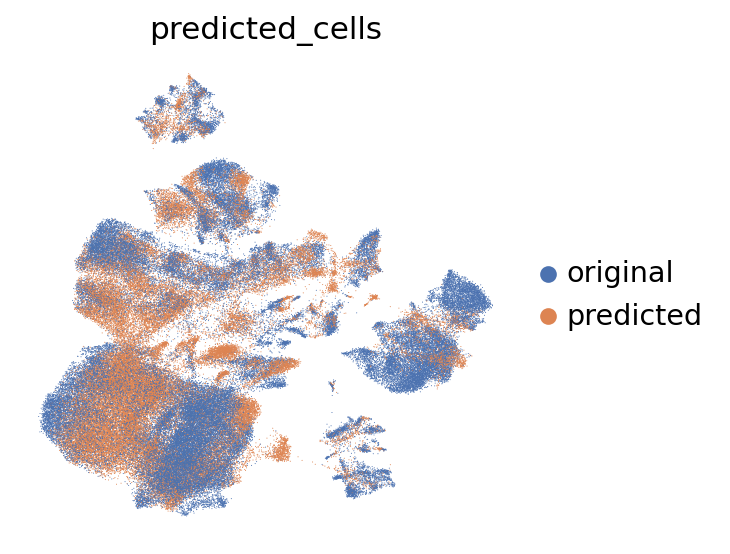

In [156]:
predicted_barcodes = query_scHPL.obs.index
atlas.obs['predicted_cells'] = atlas.obs_names.isin(predicted_barcodes)
atlas.obs['predicted_cells'] = atlas.obs['predicted_cells'].astype(str).astype('category').replace({'True': 'predicted',
                                                                                                   'False': 'original'})

sc.pl.umap(atlas, color='predicted_cells', save='predicted_original_linear_SCVI_Full.svg', palette=MY_PALETTES['deep'])

In [173]:
## Remove any remaining -Dataset string additions
mapping = { '-Kirita20':'', '-Park18':'', '-Wu19':'', '-Miao21':'', '-Dumas20': '', '-Janosevic21': ''}
for k, v in mapping.items():
    pred_query['0'] = pred_query['0'].str.replace(k,v)

In [174]:
pred_query

,0
barcode,
CAAGGCCTCGGACAAG-0-0,PTS2
GTGTTAGTCCGCTGTT-0-0,PTS2
CAGCATAGTCGCGAAA-0-0,PTS2
TTGGAACCAGCTGTAT-0-0,PTS2
CGTCAGGGTCTCTCTG-0-0,PTS2
...,...
TTTGGTTTCGATAGAA-1,PTS1
TTTGGTTTCTCCAACC-1,PTS2
TTTGTCAAGGACGAAA-1,PTS3


In [175]:
atlas.obs['Predicted_Celltype'] = pred_query

/exports/humgen/cnovellarausell/conda_envs/atlas_work/lib/python3.7/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [176]:
atlas.obs['Celltype_finest'] = atlas.obs['Celltype_finest'].astype('category')

In [177]:
atlas.obs['Celltype_finest'].cat.remove_unused_categories(inplace=True)

In [188]:
set(atlas.obs['Celltype_finest'])

{'ATL',
 'Asc-Vasa-Recta',
 'B lymph',
 'CD-Trans',
 'CNT',
 'CTAL',
 'DC',
 'DCT',
 'DCT-CNT',
 'DTL',
 'DTL-ATL',
 'Desc-Vasa-Recta',
 'Endo',
 'Fib',
 'Glom-Endo',
 'ICA',
 'ICB',
 'LOH',
 'MC',
 'MD',
 'MTAL',
 'Macro',
 'NK',
 'Neutro',
 'PC',
 'PEC',
 'PTS1',
 'PTS2',
 'PTS3',
 'PTS3T2',
 'Per',
 'Podo',
 'T lymph',
 'Vas-Afferens',
 'Vas-Efferens',
 nan}

In [189]:
atlas.obs['Celltype_finest'].replace({np.nan: 'Unknown'}, inplace=True)


In [214]:
atlas.obs['Celltype_finest'].replace({'': 'Unknown'}, inplace=True)
atlas.obs['Predicted_Celltype'].replace({'Rejected (RE)': 'root', 'Rejection (dist)': 'root'}, inplace=True)

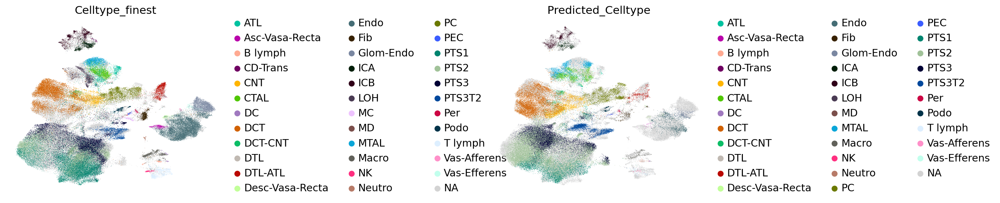

In [217]:
atlas.obs['Celltype_finest'].replace({'Unknown': np.nan}, inplace=True) # So we don't plot it

# fixed color palette
palette = {}
for n,i in enumerate(list(set(atlas.obs['Celltype_finest']))):
    palette[i] = sc.pl.palettes.default_102[n+18]
palette[np.nan] = None
atlas.obs['Predicted_Celltype'].replace({'root': np.nan}, inplace=True)
sc.pl.umap(atlas, color=['Celltype_finest', 'Predicted_Celltype'], save='atlas_originalvspredicted_SCVI_Full.svg', na_in_legend=True, palette=palette, wspace=1)
atlas.obs['Celltype_finest'].replace({np.nan: 'Unknown'}, inplace = True) # Revert previous operation

In [218]:
atlas.obs['Celltype_finest'] = atlas.obs['Celltype_finest'].replace('Unknown', '') # So when adding columns, those unknown add nothing. i.e. '' + 'PTS1' = PTS1 and not UnknownPTS1
atlas.obs['Predicted_Celltype_all'] = atlas.obs[['Celltype_finest', 'Predicted_Celltype']].apply(lambda x: x.str.cat(sep=''), axis=1)

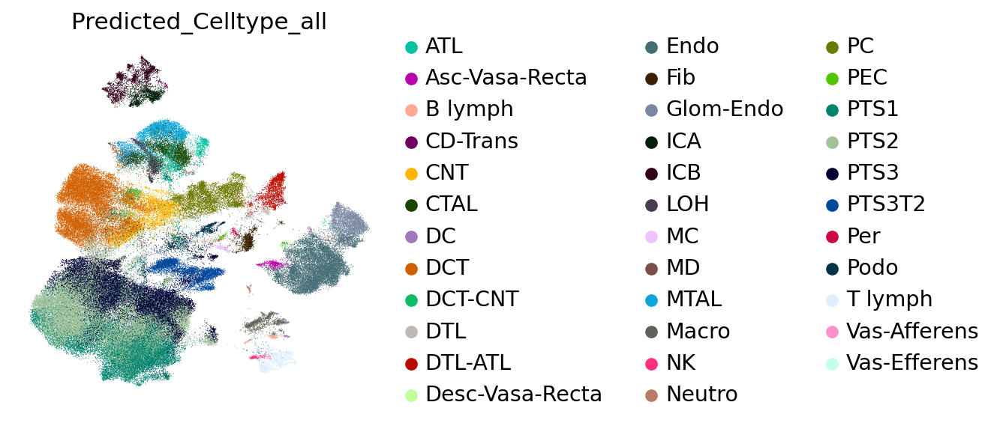

In [219]:
palette[np.nan] = None
atlas.obs['Predicted_Celltype_all'] = atlas.obs['Predicted_Celltype_all'].replace('', np.nan)
# fixed color palette
palette = {}
for n,i in enumerate(list(set(atlas.obs['Predicted_Celltype_all']))):
    palette[i] = sc.pl.palettes.default_102[n+18]
sc.pl.umap(atlas, color='Predicted_Celltype_all', save='atlas_linear_SCVI_Full_v2.svg', palette=palette, na_in_legend=False)

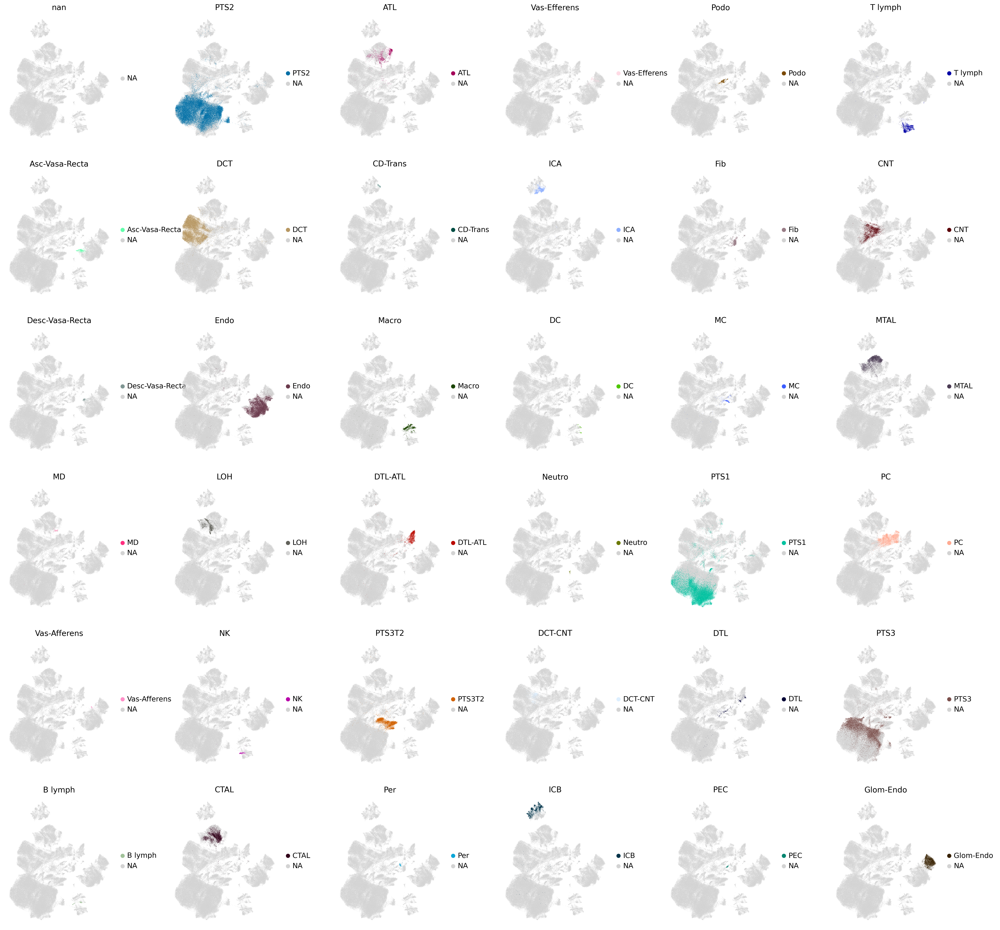

In [469]:
celltypes = list(set(atlas.obs['Predicted_Celltype_all']))
fig, axs, nrow, ncol = build_subplots(len(celltypes))

if type(axs) != np.ndarray:
      axs = [axs]
else:
      axs = axs.ravel()
        
predicted_groups = {}
for (i,n) in zip(range(nrow*ncol), celltypes):
      if i < len(celltypes):
        ax = sc.pl.umap(atlas, groups=[n], color="Predicted_Celltype_all", ax=axs[i], show=False, palette=palette)
        ax.set(title='{}'.format(n))
fig.subplots_adjust(wspace=0.5)
fig.savefig("celltype_plots_linear_SCVI_Full_v3.svg")        

In [220]:
set(atlas.obs['Predicted_Celltype_all'])

{'ATL',
 'Asc-Vasa-Recta',
 'B lymph',
 'CD-Trans',
 'CNT',
 'CTAL',
 'DC',
 'DCT',
 'DCT-CNT',
 'DTL',
 'DTL-ATL',
 'Desc-Vasa-Recta',
 'Endo',
 'Fib',
 'Glom-Endo',
 'ICA',
 'ICB',
 'LOH',
 'MC',
 'MD',
 'MTAL',
 'Macro',
 'NK',
 'Neutro',
 'PC',
 'PEC',
 'PTS1',
 'PTS2',
 'PTS3',
 'PTS3T2',
 'Per',
 'Podo',
 'T lymph',
 'Vas-Afferens',
 'Vas-Efferens',
 nan}

In [221]:
atlas.obs['Predicted_Celltype_all'].replace({np.nan:'Unknown'}, inplace=True)

In [222]:
import pickle as pkl
with open('predicted_celltype_palette.pkl', 'wb') as f:
    pickle.dump(palette, f)

In [225]:
atlas.write_h5ad('/exports/humgen/cnovellarausell/KidneyAtlas/h5ad/atlas_full_SCVI_annotated.h5ad')